# Lab. 7: Bio-Inspired Optimization

## Introduction

#### <u>The goal of this lab is to study different Bio-Inspired Optimization techniques.</u>

**Disclamer**
- When studying the effect of the parameters is extremely important to vary just one parameter at a time. Therefore, you are suggested to study one parameter by fixing all the others, and then moving to the next.

- When comparing different algorithms, is very important to run each of them several times (e.g., 30) by using different initial random seeds.

In [1]:
%%capture
!pip install cma
!pip install inspyred
!pip install benchmark_functions

In [2]:
import cma
import inspyred
import importlib
import functools
import numpy as np
from pylab import *
from inspyred import ec
from copy import deepcopy
from functools import reduce
import benchmark_functions as bf
from matplotlib import pyplot as plt
from inspyred.ec import EvolutionaryComputation
from inspyred.ec import selectors, replacers, terminators
from random import Random

### Helper functions

In [3]:
GLOBAL = 'Global'
INDIVIDUAL = 'Individual'
CORRELATED = 'Correlated'
STAR = 'star'
RING = 'ring'

class OptFun():
    def __init__(self, wf):
        self.f = wf
        self.history = []
        self.__name__ = f'OptFun({wf.__class__})'

    def __call__(self, candidates, *args, **kwargs):
        """
        Evaluate the objective function for a list of candidates.
        """
        y = []
        for x0 in candidates:
            self.history.append(deepcopy(x0))
            y.append(self.f(x0))
        return y

    def minima(self):
        return self.f.minima()

    def bounder(self):
        def fcn(candidate, *args):
            bounds = self.f.suggested_bounds()

            for i, (m, M) in enumerate(zip(*bounds)):
                if candidate[i] < m:
                    candidate[i] = m
                if candidate[i] > M:
                    candidate[i] = M
            return candidate
        return fcn

    def bounds(self):
        """
        Return the bounds of the objective function.
        """
        return self._convert_bounds(self.f.suggested_bounds())

    def heatmap(self, fn = None):
        plt.clf()
        resolution = 50
        fig = plt.figure()
        fig.canvas.manager.set_window_title('Benchmark Function: '+self.f._name)
        fig.suptitle(self.f._name)
        bounds_lower, bounds_upper = self.f.suggested_bounds()
        x = np.linspace(bounds_lower[0], bounds_upper[0], resolution)
        if self.f._n_dimensions>1:
            y = np.linspace(bounds_lower[1], bounds_upper[1], resolution)
            X, Y = np.meshgrid(x, y)
            Z = np.asarray([[self.f((X[i][j],Y[i][j])) for j in range(len(X[i]))] for i in range(len(X))])

        plt.contour(x,y,Z,15,linewidths=0.5,colors='k') # hight lines
        plt.contourf(x,y,Z,15,cmap='viridis', vmin=Z.min(), vmax=Z.max()) # heat map
        plt.xlabel('x')
        plt.ylabel('y')
        cbar = plt.colorbar()
        cbar.set_label('z')
        if len(self.history)>0:	# plot points
            xdata = [x[0] for x in self.history]
            ydata = [x[1] for x in self.history]
            plt.plot(xdata, ydata, "or-", markersize=3, linewidth=1)
        if fn is None:
            plt.show()
        else:
            plt.savefig(fn, dpi=400)

    def plot(self):
        """
        Plot the history of the objective function values.
        """
        plt.clf()
        values = [self.f(v) for v in self.history]
        min_value = self.f.minima()[0].score
        plt.plot(values)
        plt.axhline(min_value, color="r", label="optimum")
        plt.legend(loc="upper right")
        plt.show()

    def _convert_bounds(self, bounds):
        """
        Convert bounds to a list of tuples.
        """
        return [(bounds[0][i], bounds[1][i]) for i in range(len(bounds[0]))]

    def current_calls(self):
        """
        Return the number of calls to the objective function.
        """
        return len(self.history)

In [4]:
def choice_without_replacement(rng, n, size) :
    result = set()
    while len(result) < size :
        result.add(rng.randint(0, n))
    return result

class NumpyRandomWrapper(RandomState):
    def __init__(self, seed=None):
        super(NumpyRandomWrapper, self).__init__(seed)

    def sample(self, population, k):
        if isinstance(population, int) :
            population = range(population)

        return asarray([population[i] for i in
                        choice_without_replacement(self, len(population), k)])

    def random(self):
        return self.random_sample()

    def gauss(self, mu, sigma):
        return self.normal(mu, sigma)

def initial_pop_observer(population, num_generations, num_evaluations,
                         args):
    if num_generations == 0 :
        args["initial_pop_storage"]["individuals"] = asarray([guy.candidate
                                                 for guy in population])
        args["initial_pop_storage"]["fitnesses"] = asarray([guy.fitness
                                          for guy in population])

def generator(random, args):
    return asarray([random.uniform(args["pop_init_range"][0],
                                   args["pop_init_range"][1])
                    for _ in range(args["num_vars"])])

def generator_wrapper(func):
        @functools.wraps(func)
        def _generator(random, args):
            return asarray(func(random, args))
        return _generator

# helper function used to store the various populations at each generation
def my_archiver(random, population, archive, args):
    archive.append(population)
    return archive


def run_ga(random, func, num_vars=0,
           maximize=False, **kwargs) :

    #create dictionaries to store data about initial population, and lines
    initial_pop_storage = {}

    algorithm = ec.EvolutionaryComputation(random)
    algorithm.terminator = ec.terminators.generation_termination
    algorithm.replacer = ec.replacers.generational_replacement
    algorithm.variator = [ec.variators.uniform_crossover,ec.variators.gaussian_mutation]
    algorithm.selector = ec.selectors.tournament_selection
    algorithm.archiver = my_archiver
    algorithm.observer = initial_pop_observer

    kwargs["num_selected"]=kwargs["pop_size"]

    kwargs["bounder"]=func.bounder()
    kwargs["generator"]=generator

    final_pop = algorithm.evolve(evaluator=func,
                          maximize=False,
                          initial_pop_storage=initial_pop_storage,
                          num_vars=num_vars,
                          **kwargs)

    all_populations = algorithm.archive
    for i in range(len(all_populations)):
        all_populations[i] = [elem.candidate for elem in all_populations[i]]

    #best_guy = final_pop[0].candidate
    #best_fitness = final_pop[0].fitness
    final_pop_fitnesses = asarray([guy.fitness for guy in final_pop])
    final_pop_candidates = asarray([guy.candidate for guy in final_pop])

    sort_indexes = sorted(range(len(final_pop_fitnesses)), key=final_pop_fitnesses.__getitem__)
    final_pop_fitnesses = final_pop_fitnesses[sort_indexes]
    final_pop_candidates = final_pop_candidates[sort_indexes]

    best_guy = final_pop_candidates[0]
    best_fitness = final_pop_fitnesses[0]

    return best_guy, best_fitness, final_pop, all_populations


class ES(EvolutionaryComputation):
    """Evolution Strategy EC

    This class is a stub for you to implement progressively more
    sophisticated evolution strategies.

    Optional keyword arguments in ``evolve`` args parameter that you
    will need add support for:

    - *strategy_mode* -- One of {None, 'global', 'individual', 'correlated'}
    - *epsilon* -- the minimum allowed strategy parameter (default 0.00001)
    - *tau* -- a global proportionality constant (default None)
    - *tau_i* -- an individual proportionality constant (default None)
    - *num_offspring* -- number of offspring to generate at each iteration
                        (``\\lambda``) should be a multiple of \\mu
    - *mixing_number* -- mixing number (``\\rho``) (number of parents
                        involved in producing each offspring),
                        default 1 (no-mixing)

    If *tau* is ``None``, it will be set to ``1 / sqrt(2*n)``, where
    ``n`` is the length of a candidate. If *tau_i* is ``None``, it will be
    set to ``1 / sqrt(2*sqrt(n))``.

    """
    def __init__(self, random):
        EvolutionaryComputation.__init__(self, random)
        self.selector = selectors.default_selection
        self.variator = self._internal_variation
        #self.replacer = replacers.comma_replacement
        self.replacer = replacers.plus_replacement

    def elementary_rotation(self, p, q, alphas):
        R = ones((self.num_vars, self.num_vars))

        # taken from Schwefel et al "Contemporary Evolution Strategies"
        k = int(0.5 * (2*self.num_vars - p - 1) * (p + 2) -
                2*self.num_vars + q)
        cos_alpha = cos(alphas[k])
        sin_alpha = sin(alphas[k])
        R[p][p] = cos_alpha
        R[q][q] = cos_alpha
        R[p][q] = -sin_alpha
        R[q][p] = sin_alpha
        return R

    def _internal_variation(self, random, candidates, args):
        tau = args.setdefault('tau', None)
        tau_i = args.setdefault('tau', None)
        epsilon = args.setdefault('epsilon', 0.00001)

        # num_offspring (\\lambda)
        num_offspring = args.setdefault('num_offspring', len(candidates))

        mixing_number = args.setdefault('mixing_number', 1)

        if num_offspring % len(candidates) != 0 :
            raise Exception("num_offspring (\\lambda) should be a multiple " +
                            "of pop_size (\\mu)")

        mutants = []

        if tau is None:
            tau = 1. / sqrt(2 * self.num_vars)
        if tau_i is None:
            tau_i = 1. / sqrt(2 * sqrt(self.num_vars))

        while len(mutants) < num_offspring :
            parent_family_indices = random.sample([*range(len(candidates))],
                                                   mixing_number)
            parent_family = asarray([candidates[i] for i in
                                     parent_family_indices])
            parent = parent_family.mean(0)

            cand = parent[:self.num_vars].copy()
            if self.strategy_mode is None :
                strat = []
                sigma = args.setdefault('sigma', 1.0)
                if  isinstance(random, NumpyRandomWrapper) :
                    cand += random.normal(0, sigma, cand.shape)
                else :
                    for i,c in enumerate(cand) :
                        cand[i] = c + random.gauss(0, sigma)

            else :
                strat = parent[self.num_vars:].copy()

                if self.strategy_mode is GLOBAL :
                    sigmas = strat
                else :
                    sigmas = strat[:self.num_vars] #view into strat

                e_global = tau * random.gauss(0, 1)

                # more efficient with sumpy
                if  isinstance(random, NumpyRandomWrapper) :
                    sigmas *= exp(e_global + tau_i
                                  * random.normal(0, 1, sigmas.shape))
                    sigmas = maximum(sigmas, epsilon)
                else :
                    for i, s in enumerate(sigmas):
                        sigmas[i] = s * exp(e_global +
                                            tau_i * random.gauss(0, 1))
                        sigmas[i] = max(strat[i], epsilon)

                if self.strategy_mode is CORRELATED :
                    alphas = strat[self.num_vars:] #another view into strat
                    beta_squared = (5.*pi/180) ** 2 # 5 deg squared
                    if  isinstance(random, NumpyRandomWrapper) :
                        alphas += (random.normal(0,beta_squared,
                                                          alphas.shape)
                                          + pi)
                        alphas %= (2*pi)
                        alphas -= pi
                    else :
                        for j,a in enumerate(alphas) :
                            alphas[j] = ((a + random.gauss(0,beta_squared)
                                          + pi) % (2*pi)) - pi

                if self.strategy_mode is GLOBAL :
                    sigma = sigmas[0]
                    if  isinstance(random, NumpyRandomWrapper) :
                        cand = cand + random.normal(0, sigma, cand.shape)
                    else :
                        for i,c in enumerate(cand) :
                            cand[i] = c + random.gauss(0, sigma)
                elif self.strategy_mode is INDIVIDUAL :
                    if  isinstance(random, NumpyRandomWrapper) :
                        cand += random.multivariate_normal(
                                            zeros(self.num_vars),
                                            diag(sigmas**2))
                    else :
                        for i, (c, s) in enumerate(zip(cand, sigmas)):
                            cand[i] = c + random.gauss(0, s)
                else :
                    # build correlation matrix
                    T = reduce(dot,
                           [reduce(dot,
                                  [self.elementary_rotation(p,q,alphas)
                                   for q in range(p+1, self.num_vars)])
                            for p in range(self.num_vars - 1)])
                    if  isinstance(random, NumpyRandomWrapper) :
                        cand += random.multivariate_normal(
                                            zeros(self.num_vars),
                                            dot(T,diag(sigmas**2)))
                    else :
                        raise Exception("NumpyRandomWrapper required" +
                                        " for correlated mutations")

            cand = self.bounder(cand, args)
            cand = np.concatenate((cand, strat))
            mutants.append(cand)

        return mutants

    def _internal_evaluator(self, func):
        @functools.wraps(func)
        def evaluator(candidates, args):
            # convert candidates to array and then back to list
            # makes slicing easier
            return func(list(asarray(candidates)[:,0:self.num_vars]), args)
        return evaluator

    def strategize(self, generator):
        """Add strategy parameters to candidates created by a generator.

        This function decorator is used to provide a means of adding strategy
        parameters to candidates created by a generator. The generator function
        is modifed to extend the candidate with strategy parameters based on
        the strategy_mode argument passed to evolve.

        Each strategy parameter is initialized to a random value:
        in [0, 1] for ``\\sigma_i`` and in [-pi,pi] for ``\\alpha_i``

        """
        @functools.wraps(generator)
        def strategy_generator(random, args):
            candidate = generator(random, args)
            if self.strategy_mode is None :
                return candidate
            elif self.strategy_mode is GLOBAL :
                return np.concatenate( (candidate, [random.random()]) )
            else :
                sigmas = [random.random() for _ in range(self.num_vars)]
                if self.strategy_mode is INDIVIDUAL :
                    return np.concatenate( (candidate, sigmas) )
                elif self.strategy_mode is CORRELATED :
                    # since have python random, do it like this... would be
                    # better with numpy
                    alphas = [random.uniform(-pi, pi)
                              for _ in range((self.num_vars**2 -
                                              self.num_vars)//2)]
                    return np.concatenate( (candidate, alphas, sigmas) )

        return strategy_generator

    def evolve(self, generator, evaluator, pop_size=100, seeds=None,
               maximize=False, bounder=None, strategy_mode=None, num_vars=None,
               **args):
        self.strategy_mode = strategy_mode
        self.num_vars = num_vars

        generator = self.strategize(generator)
        evaluator = self._internal_evaluator(evaluator)
        return EvolutionaryComputation.evolve(self, generator, evaluator,
                                              pop_size, maximize=maximize,
                                              num_vars=num_vars,
                                              bounder=bounder, **args)


def run_es(random, func, num_vars=0,
           maximize=False, **kwargs) :

    #create dictionaries to store data about initial population, and lines
    initial_pop_storage = {}

    algorithm = ES(random)
    algorithm.terminator = terminators.generation_termination

    algorithm.observer = initial_pop_observer
    algorithm.archiver = my_archiver

    kwargs["num_selected"]=kwargs["pop_size"]
    kwargs["bounder"]=func.bounder()
    kwargs["generator"]=generator_wrapper(generator)

    final_pop = algorithm.evolve(evaluator=func,
                          maximize=maximize,
                          initial_pop_storage=initial_pop_storage,
                          num_vars=num_vars,
                          **kwargs)
    all_populations = algorithm.archive
    for i in range(len(all_populations)):
        all_populations[i] = [elem.candidate for elem in all_populations[i]]

    #best_guy = final_pop[0].candidate[0:num_vars]
    #best_fitness = final_pop[0].fitness
    final_pop_fitnesses = asarray([guy.fitness for guy in final_pop])
    final_pop_candidates = asarray([guy.candidate[0:num_vars] for guy in final_pop])

    sort_indexes = sorted(range(len(final_pop_fitnesses)), key=final_pop_fitnesses.__getitem__)
    final_pop_fitnesses = final_pop_fitnesses[sort_indexes]
    final_pop_candidates = final_pop_candidates[sort_indexes]

    best_guy = final_pop_candidates[0]
    best_fitness = final_pop_fitnesses[0]

    return best_guy, best_fitness, final_pop, all_populations

# This class inherit from the original inspyred.swarm.PSO class to allow archive
# of all the populations at each generation
class PSO(inspyred.swarm.PSO):
    def _swarm_archiver(self, random, population, archive, args):
        self.swarm_archive.append(population)
        if len(archive) == 0:
            return population[:]
        else:
            new_archive = []
            for i, (p, a) in enumerate(zip(population[:], archive[:])):
                if p < a:
                    new_archive.append(a)
                else:
                    new_archive.append(p)
            return new_archive

def run_pso(random, func, num_vars=0, maximize=False, **kwargs):

    #create dictionaries to store data about initial population, and lines
    initial_pop_storage = {}

    algorithm = PSO(random)
    algorithm.swarm_archive = []
    algorithm.topology = inspyred.swarm.topologies.star_topology
    algorithm.terminator = ec.terminators.generation_termination

    algorithm.observer = initial_pop_observer

    if "topology" in kwargs :
        if kwargs["topology"] is STAR:
            algorithm.topology = inspyred.swarm.topologies.star_topology
        elif kwargs["topology"] is RING:
            algorithm.topology = inspyred.swarm.topologies.ring_topology

    kwargs["num_selected"]=kwargs["pop_size"]
    kwargs["bounder"]= func.bounder()
    kwargs["generator"]=generator

    final_pop = algorithm.evolve(evaluator=func,
                          maximize=maximize,
                          initial_pop_storage=initial_pop_storage,
                          num_vars=num_vars,
                          **kwargs)

    all_populations = []
    for i in range(len(algorithm.swarm_archive)):
        all_populations.append([elem.candidate for elem in algorithm.swarm_archive[i]])

    final_pop_fitnesses = asarray([guy.fitness for guy in final_pop])
    final_pop_candidates = asarray([guy.candidate for guy in final_pop])

    sort_indexes = sorted(range(len(final_pop_fitnesses)), key=final_pop_fitnesses.__getitem__)
    final_pop_fitnesses = final_pop_fitnesses[sort_indexes]
    final_pop_candidates = final_pop_candidates[sort_indexes]

    best_guy = final_pop_candidates[0]
    best_fitness = final_pop_fitnesses[0]

    return best_guy, best_fitness, final_pop, all_populations

In [5]:
def plot_population_evolution(populations, objective_fun, generation_step=1):
    plt.clf()
    resolution = 50
    fig, ax = plt.subplots(2, 3)
    ax = ax.flatten()
    fig.set_figwidth(10)
    fig.set_figheight(7)

    bounds_lower, bounds_upper = objective_fun.f.suggested_bounds()
    x = np.linspace(bounds_lower[0], bounds_upper[0], resolution)
    if objective_fun.f._n_dimensions>1:
        y = np.linspace(bounds_lower[1], bounds_upper[1], resolution)
        X, Y = np.meshgrid(x, y)
        Z = np.asarray([[objective_fun.f((X[i][j],Y[i][j])) for j in range(len(X[i]))] for i in range(len(X))])

    for i in range(min(len(populations),6)):
        if i*generation_step<len(populations):
          ax[i].contour(x,y,Z,15,linewidths=0.5,colors='k')
          ax[i].contourf(x,y,Z,15,cmap='viridis', vmin=Z.min(), vmax=Z.max()) # heat map
          ax[i].set_xlabel('x')
          ax[i].set_ylabel('y')
          ax[i].title.set_text("Generation " + str(i*generation_step))

          # scatter plot of the population
          current_pop = populations[i*generation_step]
          xdata = [x[0] for x in current_pop]
          ydata = [x[1] for x in current_pop]
          ax[i].scatter(xdata, ydata, color="r", zorder=2, label="population")

    handles, labels = ax[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper right')
    plt.tight_layout()
    plt.show()

### Exercises

#### Exercise 1/3: Genetic algorithms

1. Compare the results of mutation-only vs crossover-only

A solution based exclusively on mutation tends to reach the optimal value more effectively. This is due to the fact that mutation allows for greater exploration of the search space, resulting in a genetic 'random walk.' Despite this randomness in movement through the solution space, the selection of the next population favors the better offspring, allowing the population to converge towards the optimum.
Conversely, an approach based solely on crossover may be less effective in reaching the optimum. Crossover tends to produce offspring that are similar to the parents, limiting genetic diversity within the population and confining the solutions to the initial population.
Increasing the probability of crossover does not seem to significantly influence the final outcome, as the offspring generated will still be similar to the parents. On the other hand, increasing the probability of mutation can lead to greater genetic diversity and allow for finding better solutions more quickly. However, a high probability of mutation can also make it more difficult to find the optimal minimum, as the mutation process is more random and less directional.

2. Fixing the mutation probability, compare different values for the crossover


When the mutation probability is fixed and the values of crossover are varied, it is observed that increasing the latter leads to better and faster solutions. This occurs because, with a constant mutation probability, increasing the probability of crossover allows parents to combine their characteristics more frequently, thereby generating greater genetic diversity in the population of offspring.

3. How does the selective pressure (i.e., tournament size) affect the search?

By increasing the tournament size, I sample a larger number of individuals, thus making the search more costly, but it is more likely that I find better individuals in the larger random sample. Therefore, it is more probable that the search reaches optimal values more quickly.

4. Compare the search process on different benchmark functions

With simple and unimodal functions such as DeJong3, it is generally possible to find the minimum without problems, even with low probabilities of crossover and mutation. Since these functions have a single optimization region, the genetic algorithm tends to converge quickly towards the global minimum.
With more complex unimodal functions like the Picheny-Goldstein-Price, it might be necessary to slightly increase the probabilities of crossover and mutation, as well as to increase the tournament size. This is because these functions may present more complex curvatures and may require more extensive exploration of the solution space to find the global minimum.
However, with multimodal and much more complex functions, searching for the global minimum can become extremely difficult. In these situations, a small initial population might not be sufficient to adequately explore the solution space and overcome local minima. The algorithm can get trapped in local minima, especially if these have values very similar to the global minimum.

In [6]:
args = {}
args["num_vars"] = 2 # Number of dimensions of the search space
args["gaussian_stdev"] = 1.0 # Standard deviation of the Gaussian mutations
args["num_elites"] = 1 # number of elite individuals to maintain in each gen
args["pop_size"] = 20 # population size
args["max_generations"] = 50 # Number of generations of the GA

### CROSSOVER ONLY 

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0
BEST GUY: [-1.53374201  5.46452534], 	 BEST FITNESS: 13.378951737617408


<Figure size 640x480 with 0 Axes>

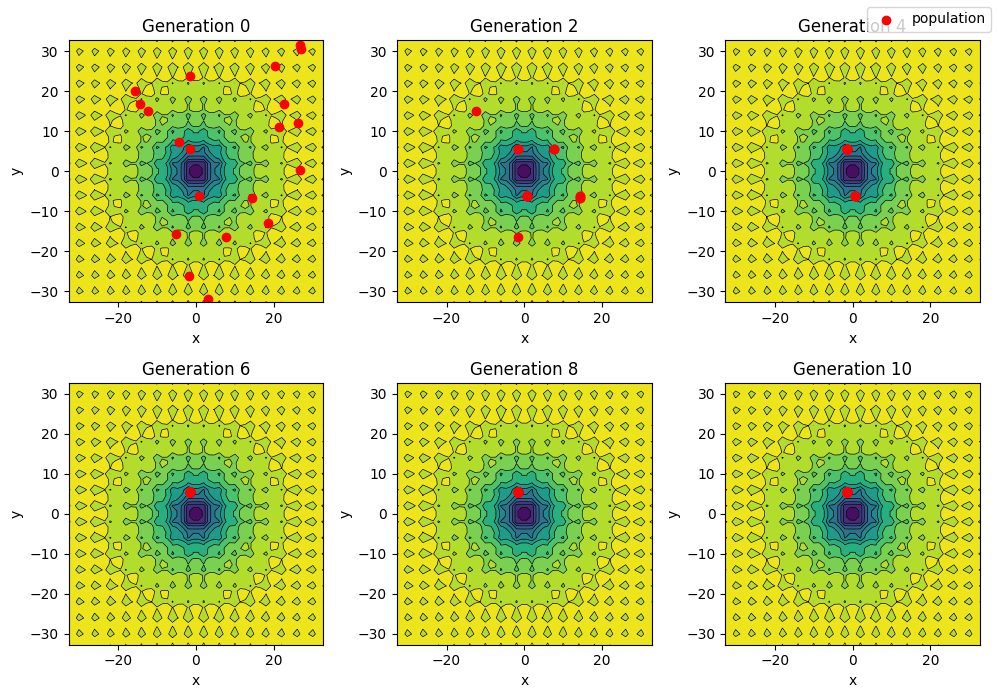

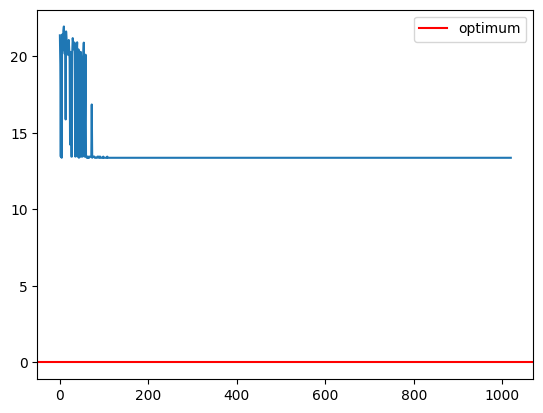

CROSSOVER RATE: 0.3, 	 MUTATION RATE: 0
BEST GUY: [0.73890014 5.46452534], 	 BEST FITNESS: 12.95558295160484


<Figure size 640x480 with 0 Axes>

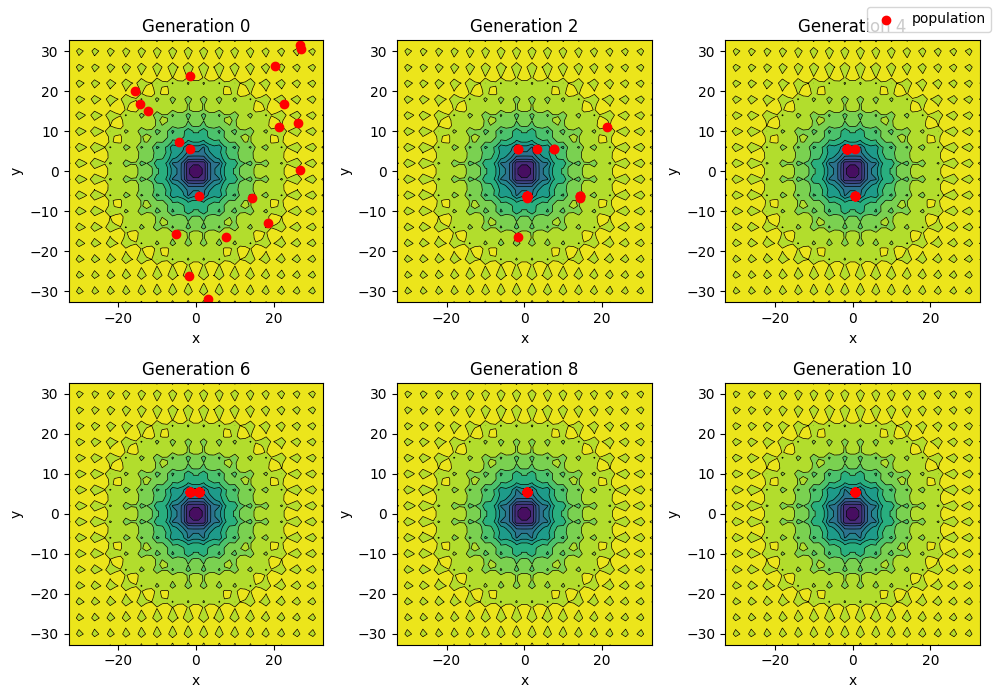

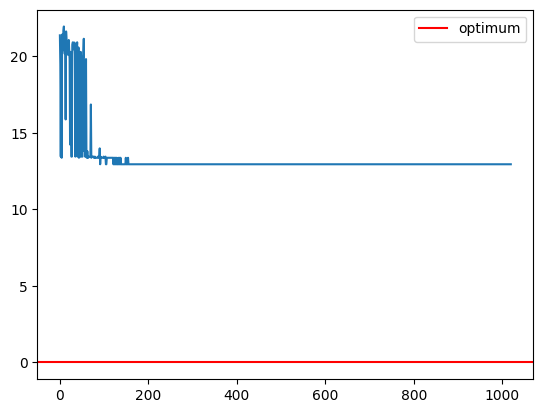

CROSSOVER RATE: 0.5, 	 MUTATION RATE: 0
BEST GUY: [0.73890014 5.46452534], 	 BEST FITNESS: 12.95558295160484


<Figure size 640x480 with 0 Axes>

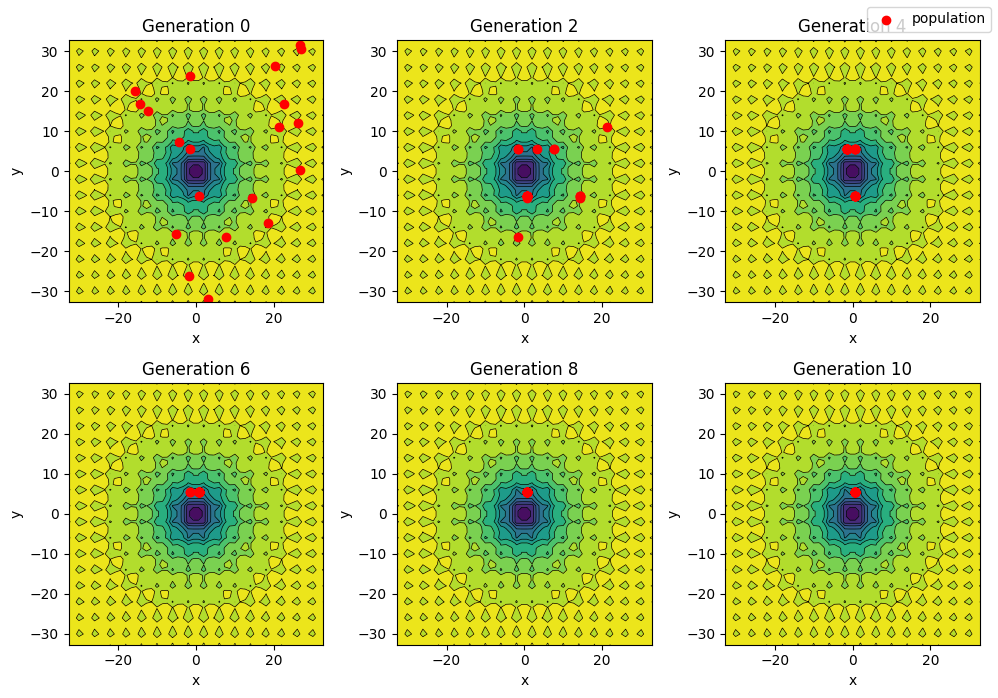

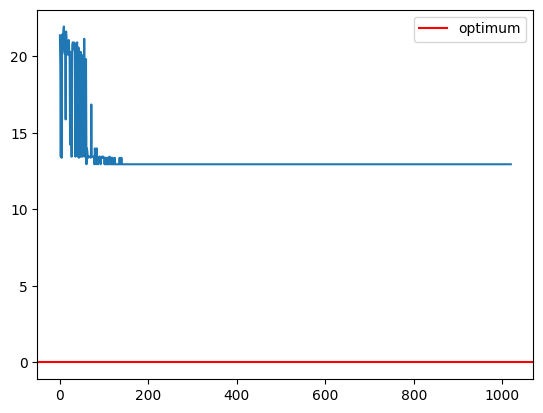

In [7]:
crossover_rate = [0.1, 0.3, 0.5]
func = OptFun(bf.Ackley(2))
args["mutation_rate"] = 0
args["tournament_size"] = 2
args["pop_init_range"] = func.bounds()[0] # Range for the initial population

for crossover in crossover_rate:
    args["pop_size"] = 20
    func = OptFun(bf.Ackley(2))
    print(f'CROSSOVER RATE: {crossover}, \t MUTATION RATE: {args["mutation_rate"]}')
    args["crossover_rate"] = crossover
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(0),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()




### MUTATION ONLY 


CROSSOVER RATE: 0, 	 MUTATION RATE: 0.1
BEST GUY: [ 0.83616016 -0.07650733], 	 BEST FITNESS: 2.9418586796126083


<Figure size 640x480 with 0 Axes>

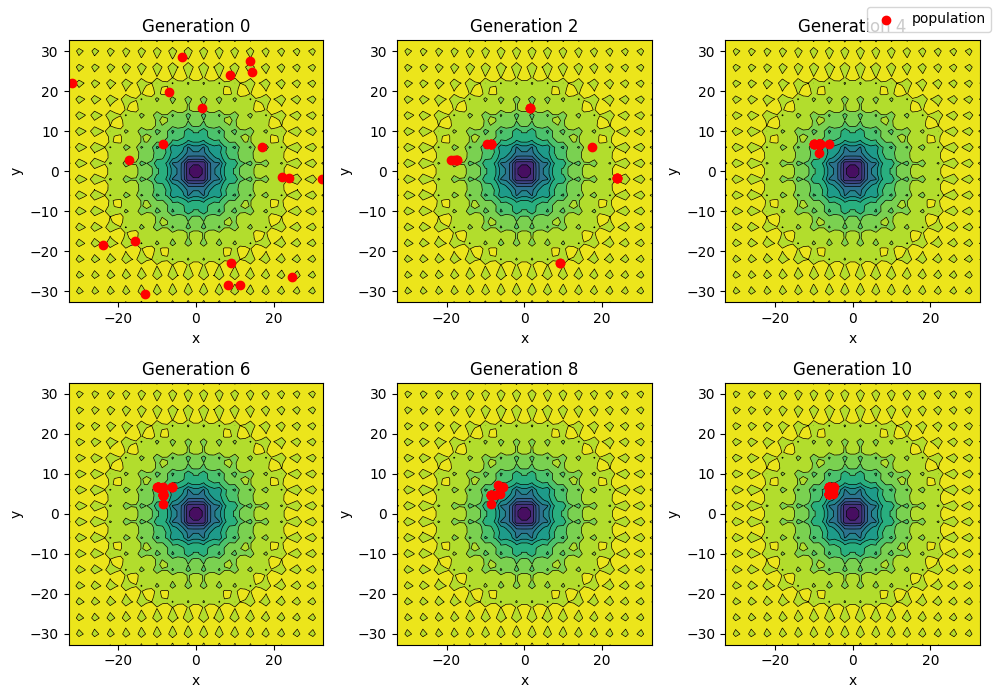

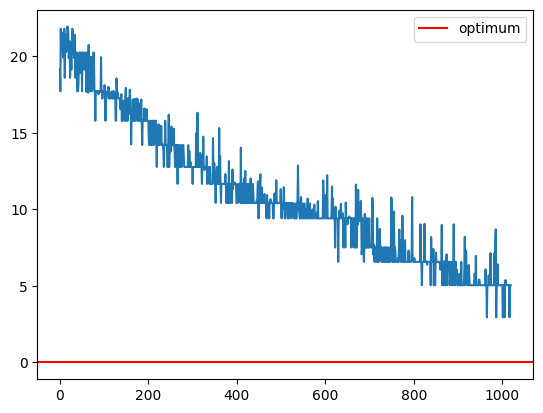

CROSSOVER RATE: 0, 	 MUTATION RATE: 0.3
BEST GUY: [-0.01736073 -0.00440832], 	 BEST FITNESS: 0.059183441456327035


<Figure size 640x480 with 0 Axes>

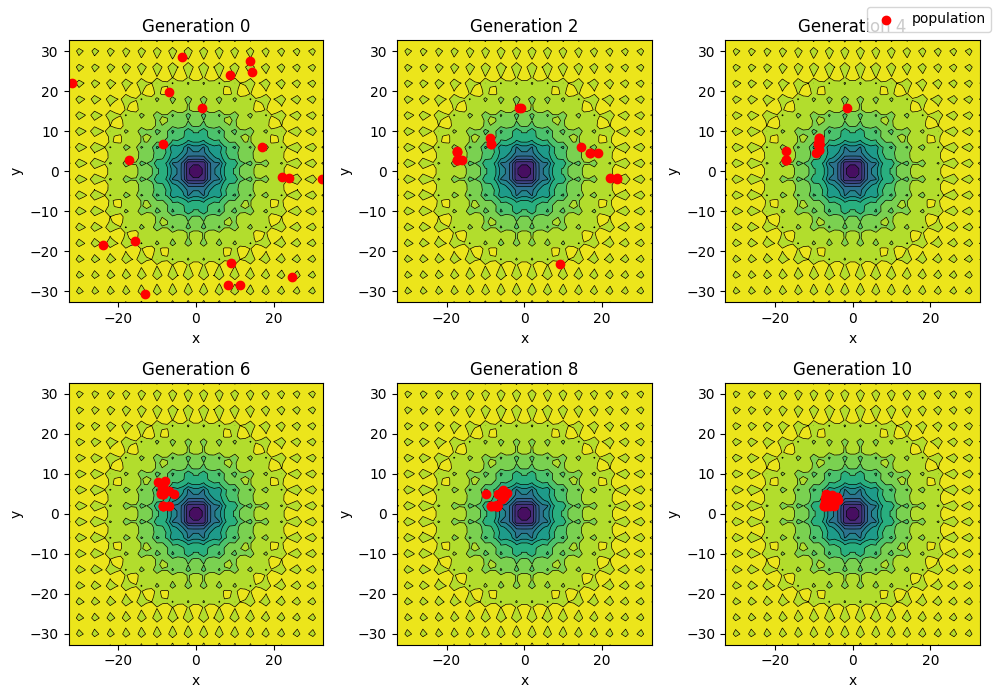

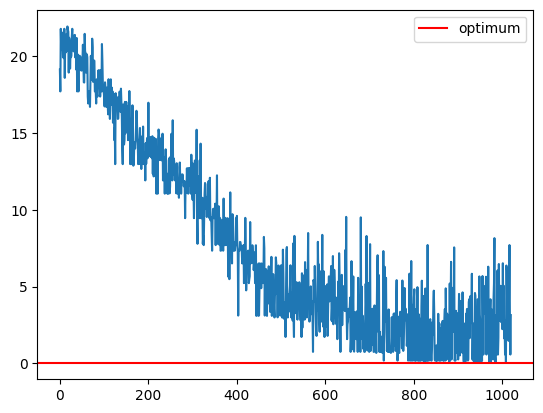

CROSSOVER RATE: 0, 	 MUTATION RATE: 0.5
BEST GUY: [-0.02881178  0.0182197 ], 	 BEST FITNESS: 0.12711570132782102


<Figure size 640x480 with 0 Axes>

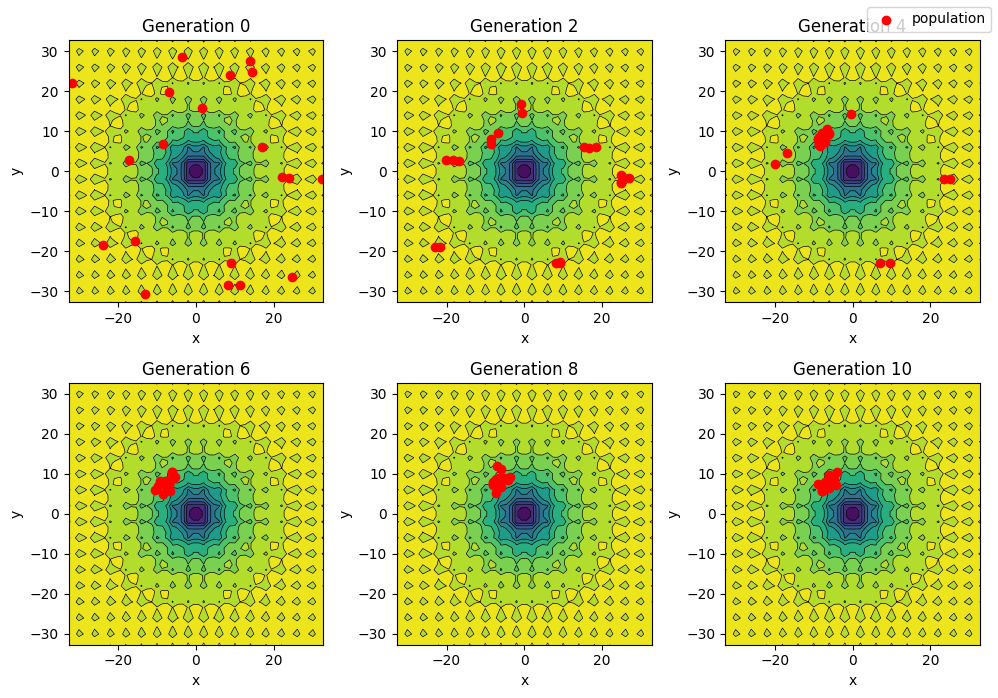

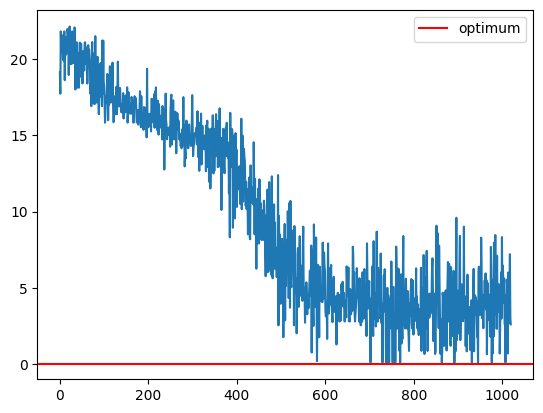

In [8]:
func = OptFun(bf.Ackley(2))
mutation_rate = [0.1, 0.3, 0.5]

args["crossover_rate"] = 0
args["tournament_size"] = 2
args["pop_init_range"] = func.bounds()[0] # Range for the initial population

for mutation in mutation_rate:
    func = OptFun(bf.Ackley(2))
    args["pop_size"] = 20
    print(f'CROSSOVER RATE: {args["crossover_rate"]}, \t MUTATION RATE: {mutation}')
    args["mutation_rate"] = mutation
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(3),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()
    

### FIX MUTATION PROBABILITY, CHANGE CROSSOVER

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.2
BEST GUY: [ 0.01920651 -0.04316038], 	 BEST FITNESS: 0.19208015653734067


<Figure size 640x480 with 0 Axes>

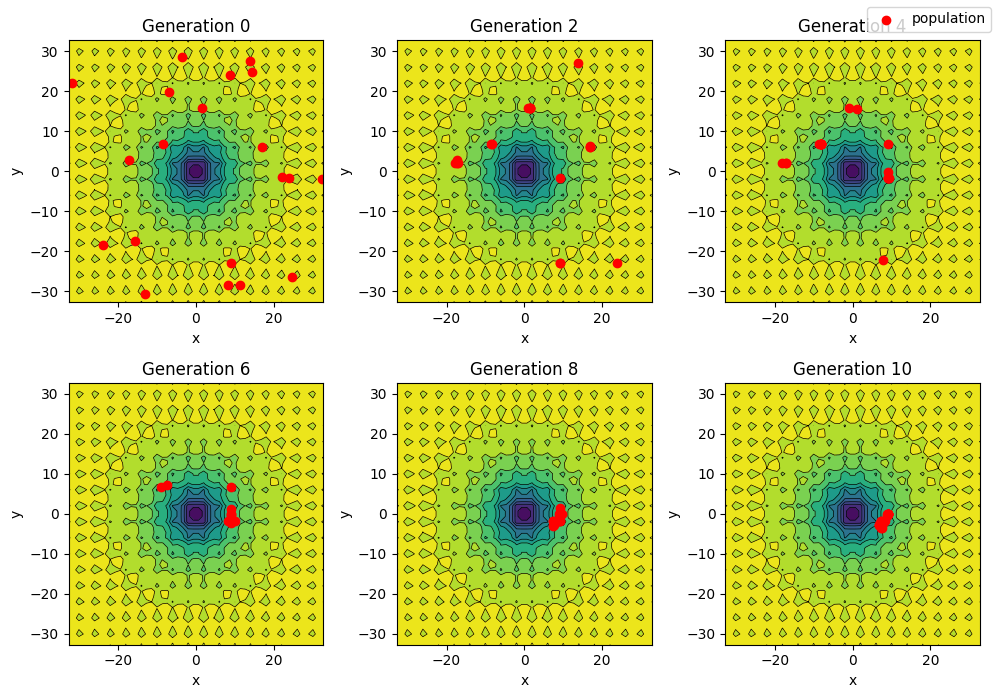

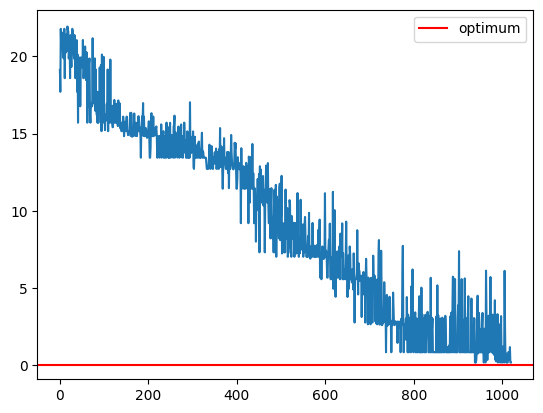

CROSSOVER RATE: 0.3, 	 MUTATION RATE: 0.2
BEST GUY: [ 0.00086003 -0.01500849], 	 BEST FITNESS: 0.04852671539871567


<Figure size 640x480 with 0 Axes>

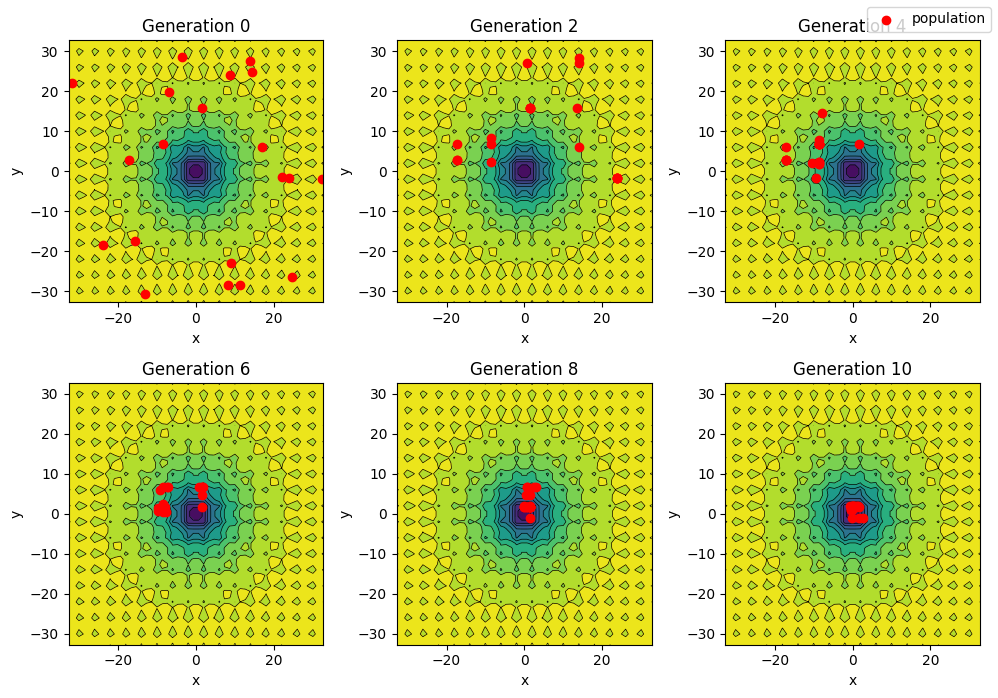

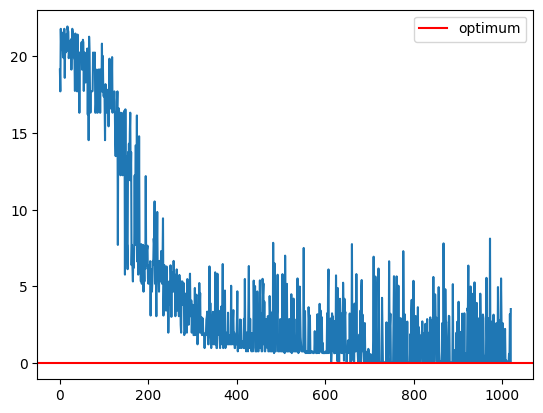

CROSSOVER RATE: 0.5, 	 MUTATION RATE: 0.2
BEST GUY: [-0.01594266  0.03932701], 	 BEST FITNESS: 0.1673392676446004


<Figure size 640x480 with 0 Axes>

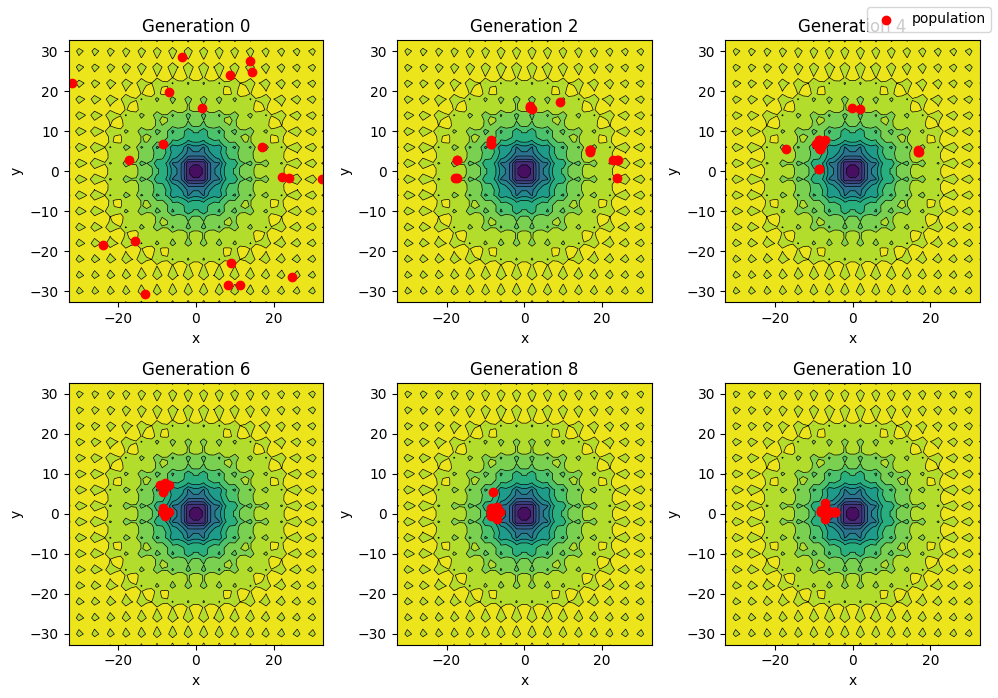

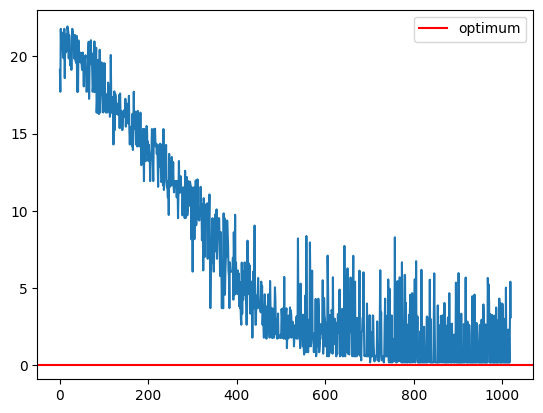

CROSSOVER RATE: 0.8, 	 MUTATION RATE: 0.2
BEST GUY: [-0.01853608  0.00346738], 	 BEST FITNESS: 0.06277958000981743


<Figure size 640x480 with 0 Axes>

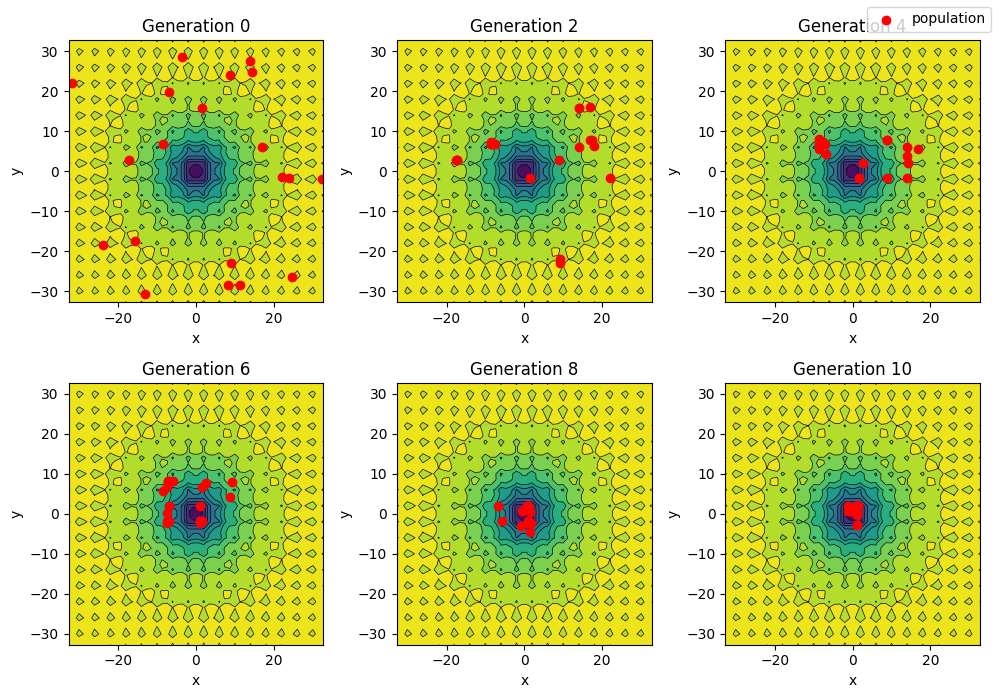

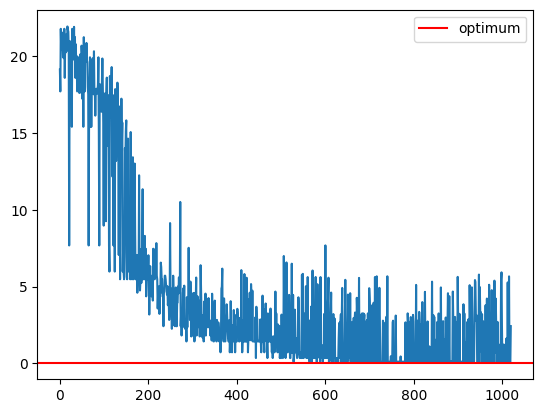

In [9]:
crossover_rate = [0.1, 0.3, 0.5, 0.8]
func = OptFun(bf.Ackley(2))
args["mutation_rate"] = 0.2
args["tournament_size"] = 2
args["pop_init_range"] = func.bounds()[0] # Range for the initial population

for crossover in crossover_rate:
    args["pop_size"] = 20
    func = OptFun(bf.Ackley(2))
    print(f'CROSSOVER RATE: {crossover}, \t MUTATION RATE: {args["mutation_rate"]}')
    args["crossover_rate"] = crossover
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(3),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()


### selective pressure


CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 2
BEST GUY: [-0.10606766 -0.13318725], 	 BEST FITNESS: 1.123337246562134


<Figure size 640x480 with 0 Axes>

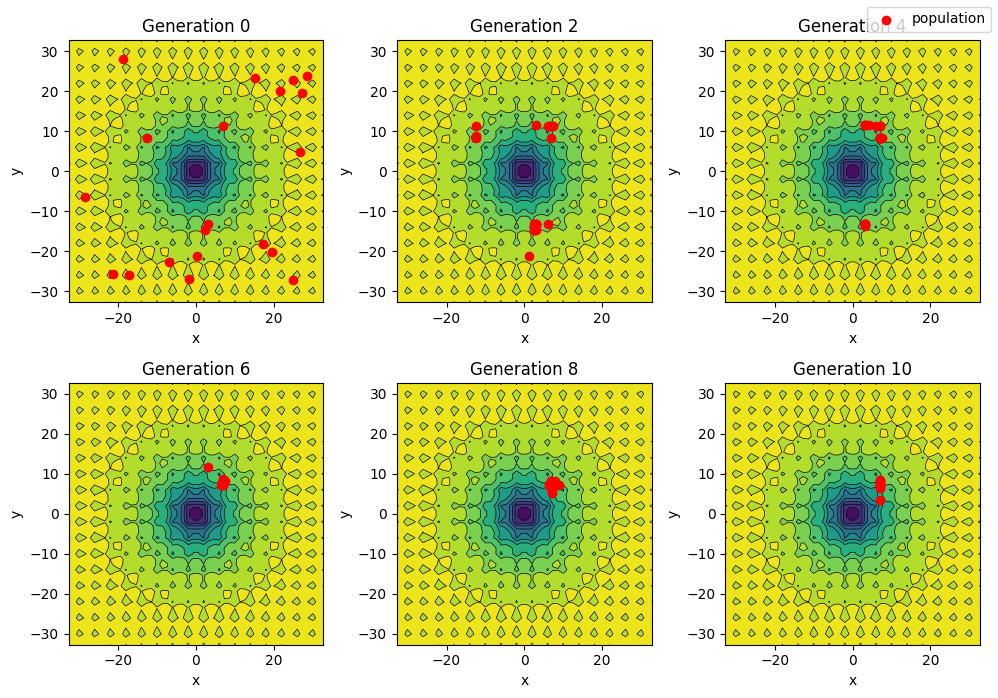

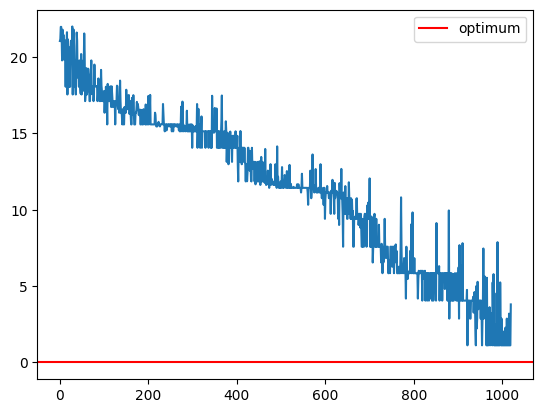

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 4
BEST GUY: [ 0.05134029 -0.07686375], 	 BEST FITNESS: 0.47618451637693626


<Figure size 640x480 with 0 Axes>

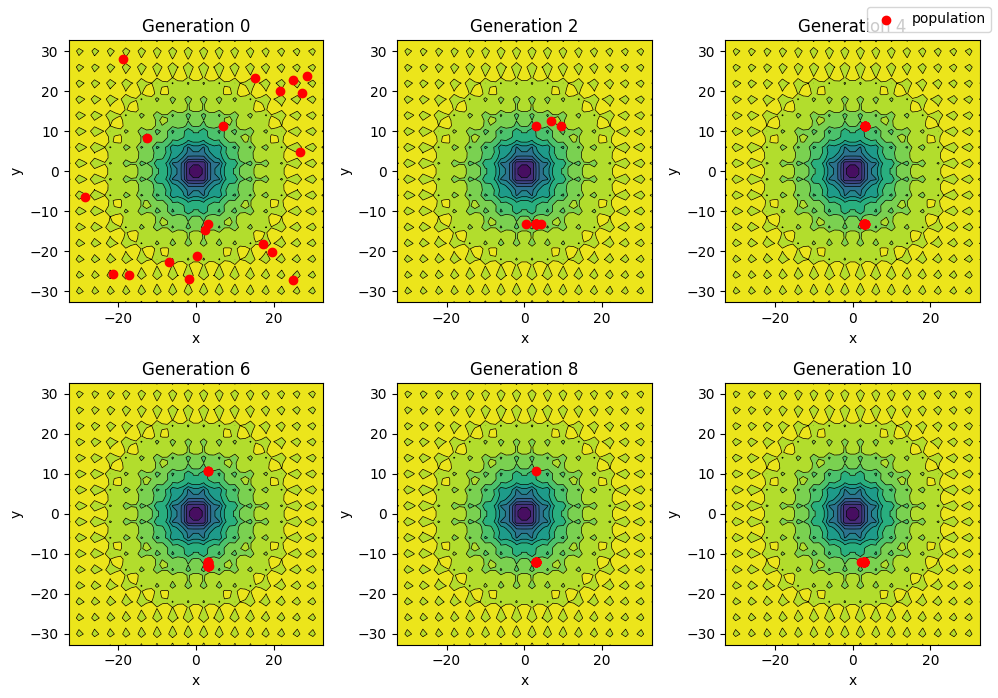

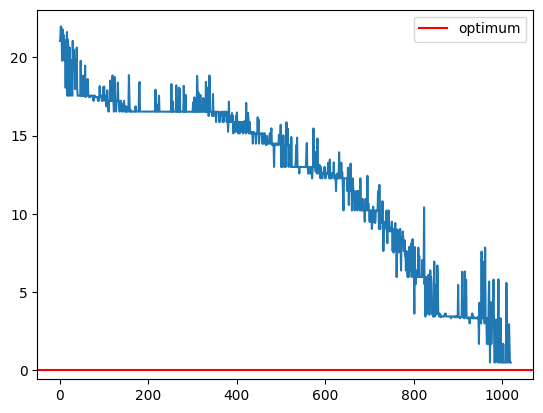

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 10
BEST GUY: [0.04682661 0.07483926], 	 BEST FITNESS: 0.44645880758606227


<Figure size 640x480 with 0 Axes>

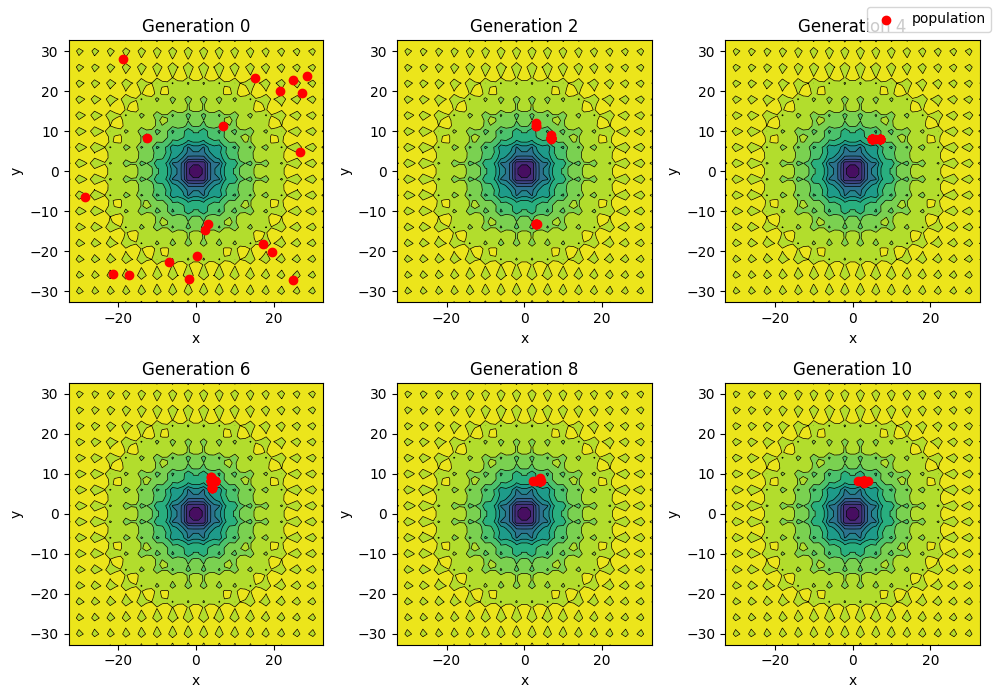

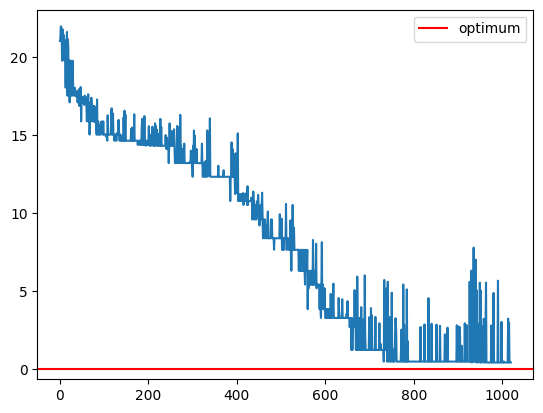

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 16
BEST GUY: [ 0.02424853 -0.00421181], 	 BEST FITNESS: 0.08566303860348201


<Figure size 640x480 with 0 Axes>

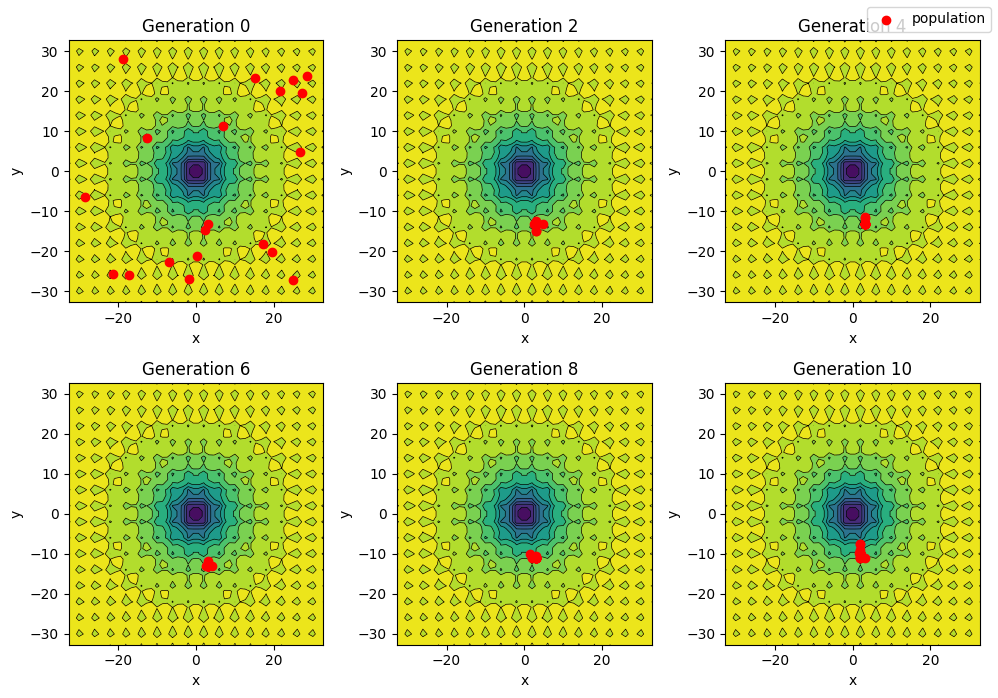

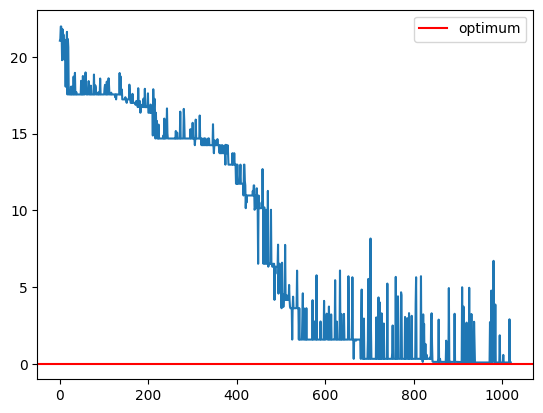

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 20
BEST GUY: [ 0.00726763 -0.08416723], 	 BEST FITNESS: 0.41831614479018286


<Figure size 640x480 with 0 Axes>

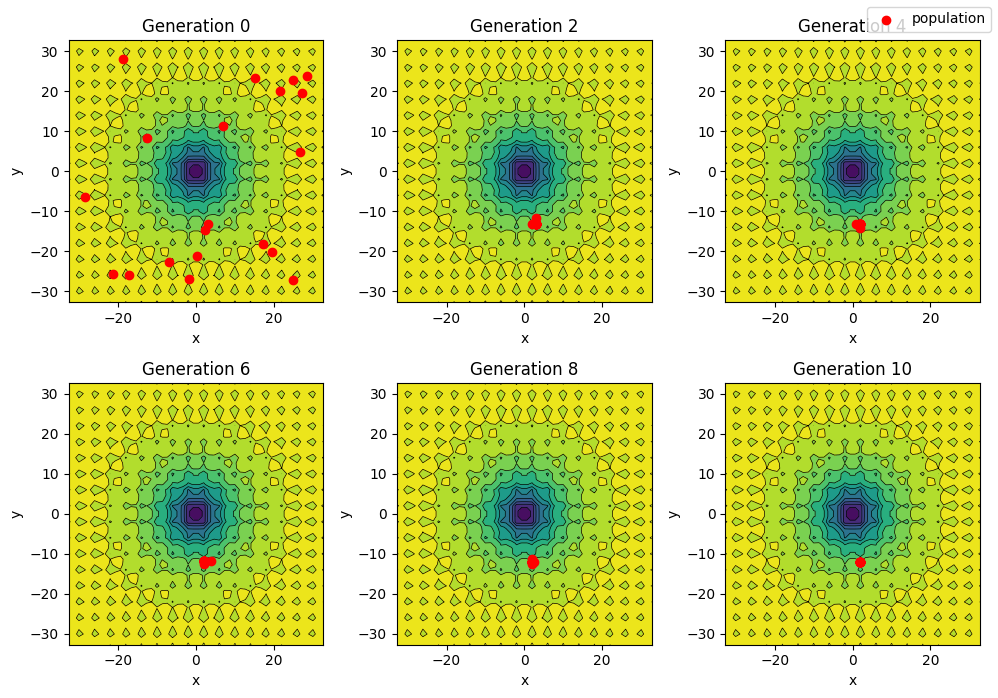

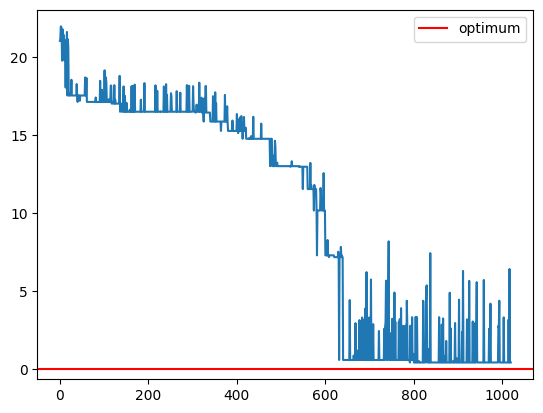

In [10]:
tournament_size = [2, 4, 10, 16, 20]
func = OptFun(bf.Ackley(2))
args["mutation_rate"] = 0.1
args["crossover_rate"] = 0.1
args["pop_init_range"] = func.bounds()[0] # Range for the initial population

for turnament in tournament_size:
    args["pop_size"] = 20
    func = OptFun(bf.Ackley(2))
    print(f'CROSSOVER RATE: {args["crossover_rate"]}, \t MUTATION RATE: {args["mutation_rate"]}, \t TURNAMENT SIZE: {turnament}')
    args["tournament_size"] = turnament
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(4),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()


### change functions

CROSSOVER RATE: 0.1, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 20
BEST GUY: [-3.8        -3.43153588], 	 BEST FITNESS: -8


<Figure size 640x480 with 0 Axes>

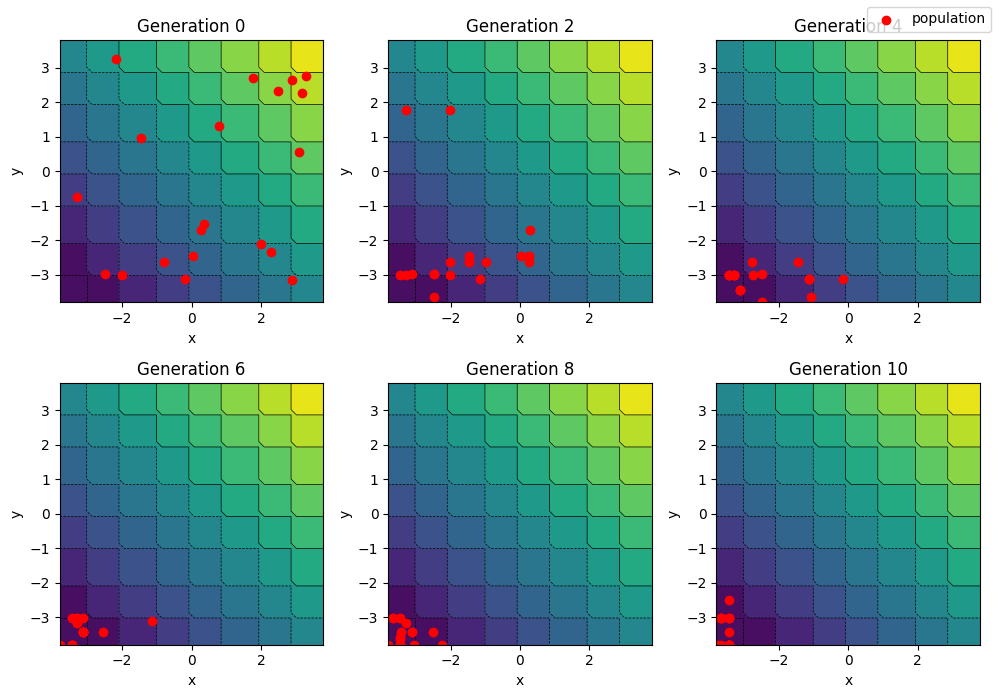

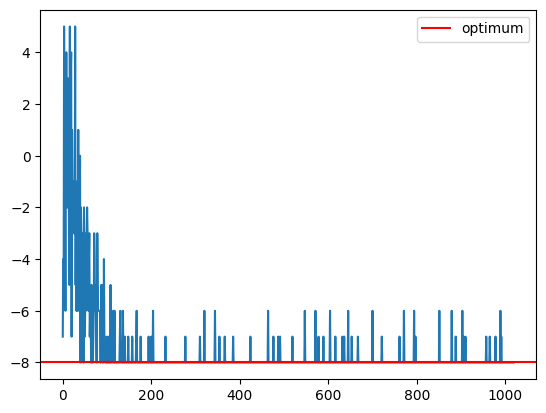

In [11]:
functions = [OptFun(bf.DeJong3(2))]

args["mutation_rate"] = 0.1
args["crossover_rate"] = 0.1
args["tournament_size"] = 2

for func in functions:
    args["pop_size"] = 20
    args["pop_init_range"] = func.bounds()[0] # Range for the initial population
    print(f'CROSSOVER RATE: {args["crossover_rate"]}, \t MUTATION RATE: {args["mutation_rate"]}, \t TURNAMENT SIZE: {turnament}')
    
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(4),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()

CROSSOVER RATE: 0.2, 	 MUTATION RATE: 0.2, 	 TURNAMENT SIZE: 20
BEST GUY: [0.50725749 0.25022837], 	 BEST FITNESS: -3.1009377242475598


<Figure size 640x480 with 0 Axes>

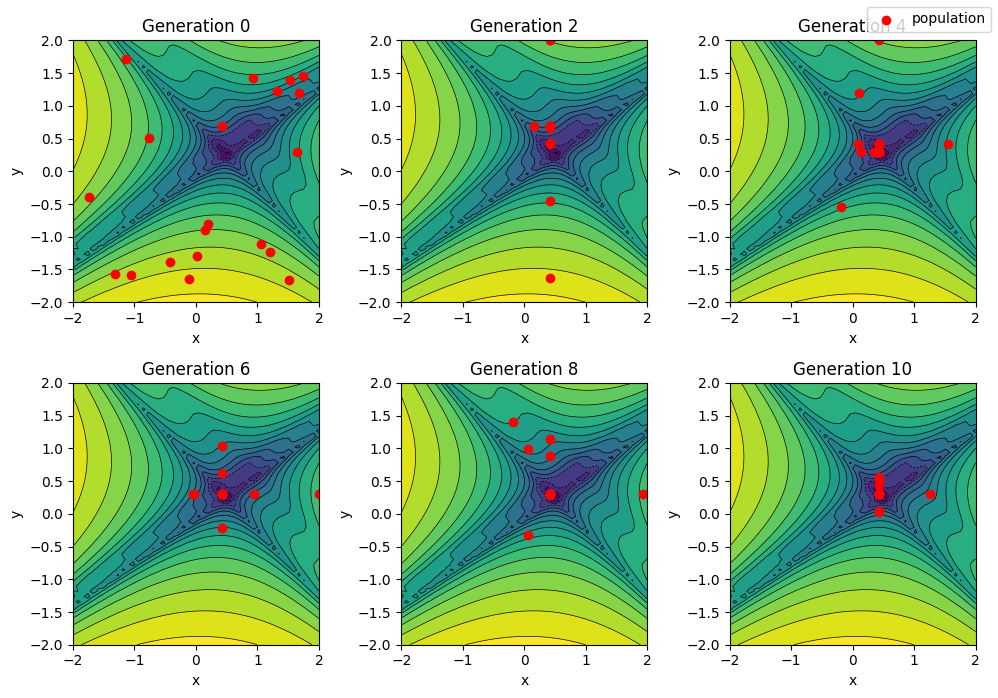

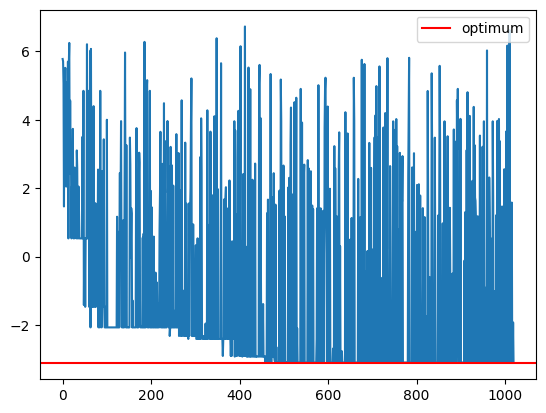

In [77]:
functions = [OptFun(bf.PichenyGoldsteinAndPrice())]
args["mutation_rate"] = 0.2
args["crossover_rate"] = 0.2
args["tournament_size"] = 10


for func in functions:
    args["pop_size"] = 20
    args["pop_init_range"] = func.bounds()[0] # Range for the initial population
    print(f'CROSSOVER RATE: {args["crossover_rate"]}, \t MUTATION RATE: {args["mutation_rate"]}, \t TURNAMENT SIZE: {turnament}')
    
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(4),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()

CROSSOVER RATE: 0.9, 	 MUTATION RATE: 0.1, 	 TURNAMENT SIZE: 20
BEST GUY: [-302.8592255  -124.76465532], 	 BEST FITNESS: 414.55976853238985


<Figure size 640x480 with 0 Axes>

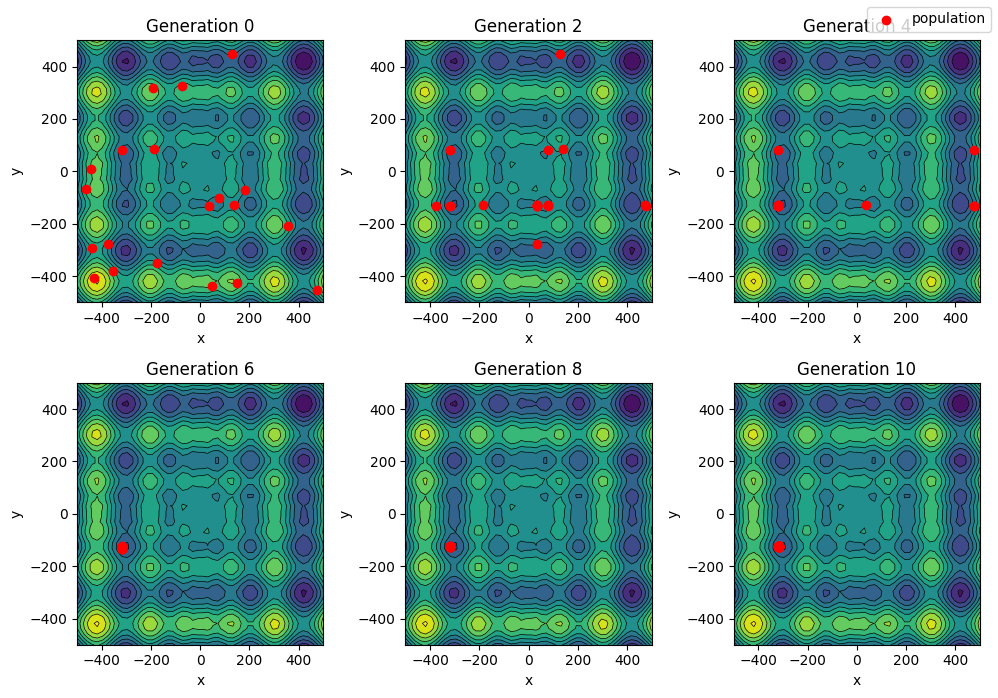

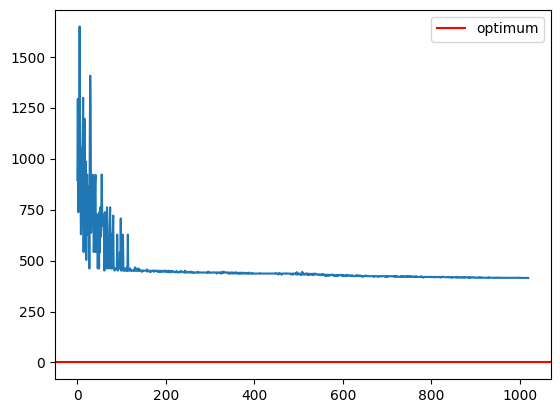

In [78]:
functions = [OptFun(bf.Schwefel(2))]
args["mutation_rate"] = 0.1
args["crossover_rate"] = 0.9
args["tournament_size"] = 2


for func in functions:
    args["pop_size"] = 20
    args["pop_init_range"] = func.bounds()[0] # Range for the initial population
    print(f'CROSSOVER RATE: {args["crossover_rate"]}, \t MUTATION RATE: {args["mutation_rate"]}, \t TURNAMENT SIZE: {turnament}')
    
    best_guy, best_fitness, final_pop, all_populations = run_ga(
        Random(7),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func, generation_step=2)
    func.plot()

#### Exercise 2/3: Evolutionary Strategies

1. How does the number of offspring  λ  parameter affect the search?

Increasing λ means increasing the genetic diversity of the new generation, thereby enhancing the ability to explore a wider portion of the solution space. This can lead to greater effectiveness in finding better solutions, allowing the algorithm to more easily overcome local minima and converge towards a global optimum.

2. How does the mixing number  ρ  affect the search?

Increasing the mixing number parameter raises the number of parents involved in creating a new individual. This leads to further genetic diversification within the population, allowing the algorithm to explore the solution space more broadly. However, this increase in diversity also leads to higher computational costs, as it requires selecting and combining a larger number of parents to generate each offspring.

3. Describe the impact of the different strategies (None/GLOBAL/INDIVIDUAL) on the search process.

**No Strategy (None):**
Without any specific strategy outlined, the generated candidates will not have any associated strategy parameter. This means that the mutation probability (sigma) will remain constant throughout the entire evolutionary process. This can limit the algorithm's ability to dynamically adapt to the problem conditions or the characteristics of the solution space.
**Global Strategy (GLOBAL):**
With the global strategy, a single mutation probability value (sigma) is associated with all candidates. This means that during the mutation process, the same mutation probability is applied to all candidates. This allows for some uniformity in exploring the solution space and can contribute to a more cohesive and less scattered search.
**Individual Strategy (INDIVIDUAL):**
With the individual strategy, each candidate has an individually associated mutation probability value (sigma). This means that during the mutation process, candidates may undergo mutations with varying intensities. This can lead to greater diversity in the population of candidates and potentially encourage broader exploration of the solution space. However, if changes are too specific to each candidate, it could also lead to increased randomness in exploration, which might make the algorithm less effective in converging toward high-quality solutions.





### lambda

NUM OFFSPRING: 20
BEST GUY: [-0.05303748  0.021048  ], 	 BEST FITNESS: 0.24601793133541294


<Figure size 640x480 with 0 Axes>

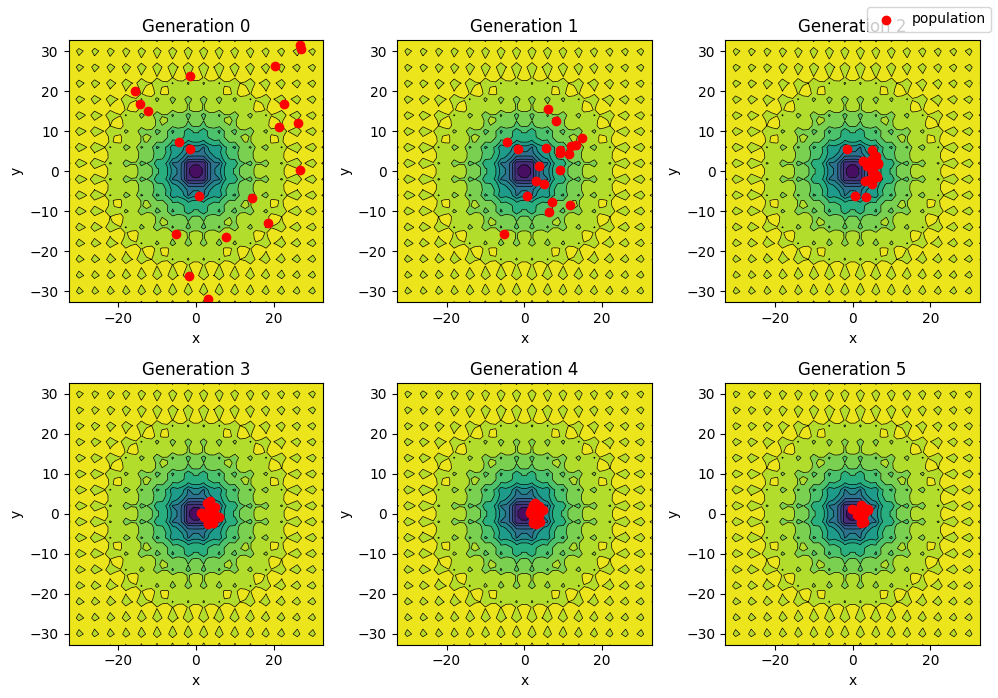

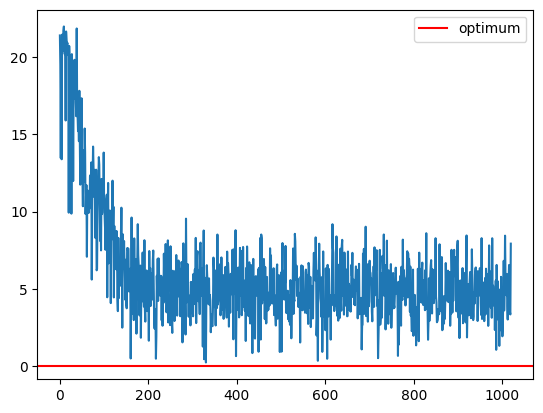

NUM OFFSPRING: 40
BEST GUY: [ 0.02024224 -0.00498242], 	 BEST FITNESS: 0.07049482709963018


<Figure size 640x480 with 0 Axes>

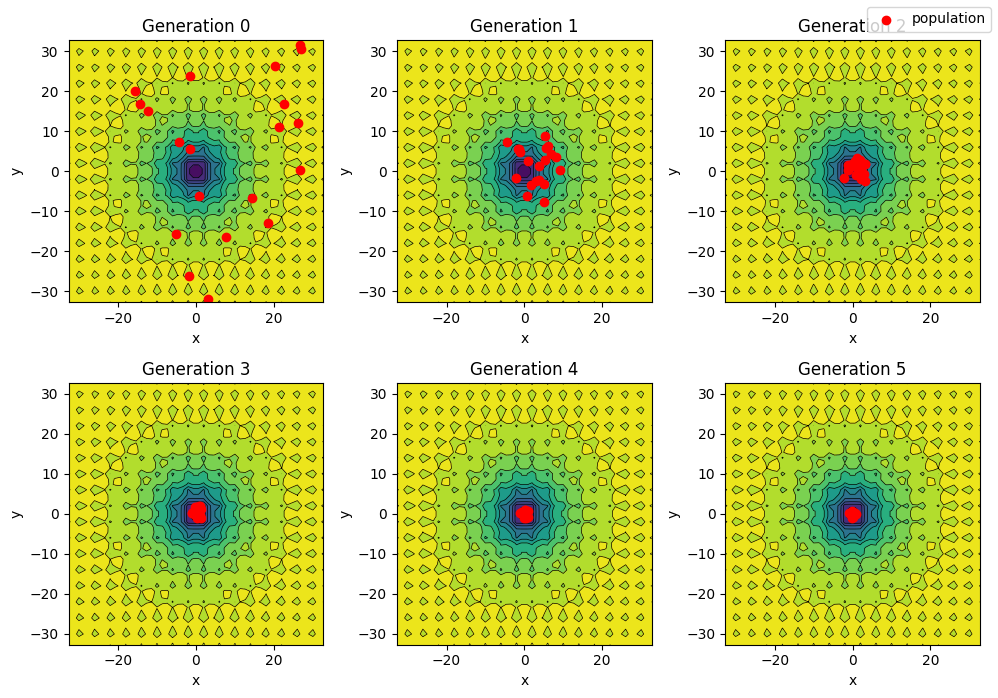

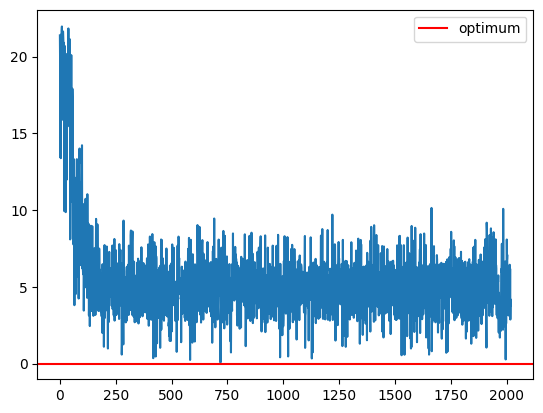

NUM OFFSPRING: 100
BEST GUY: [ 0.00581975 -0.02836721], 	 BEST FITNESS: 0.10408608124217311


<Figure size 640x480 with 0 Axes>

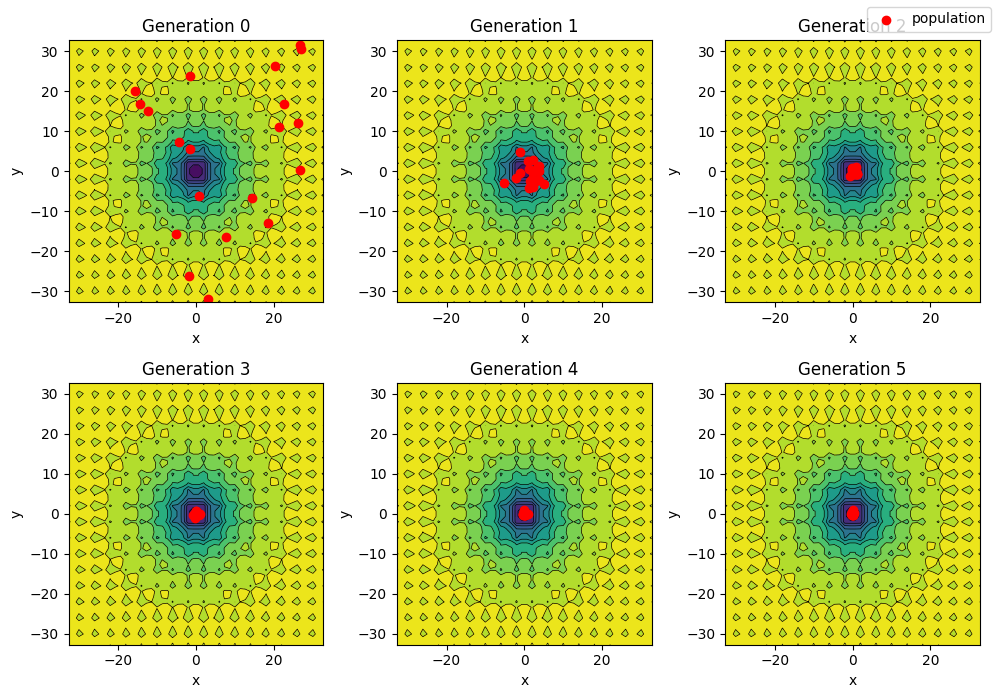

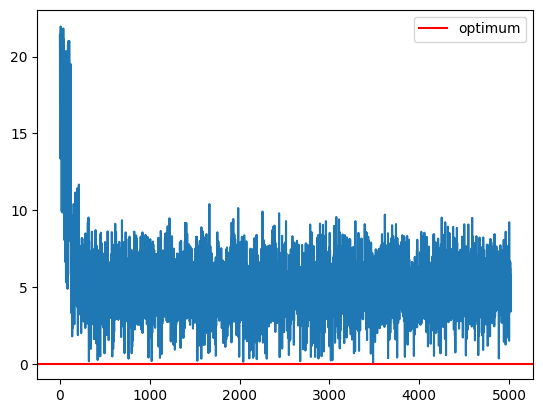

NUM OFFSPRING: 200
BEST GUY: [-0.00863557  0.00700094], 	 BEST FITNESS: 0.03473163191897344


<Figure size 640x480 with 0 Axes>

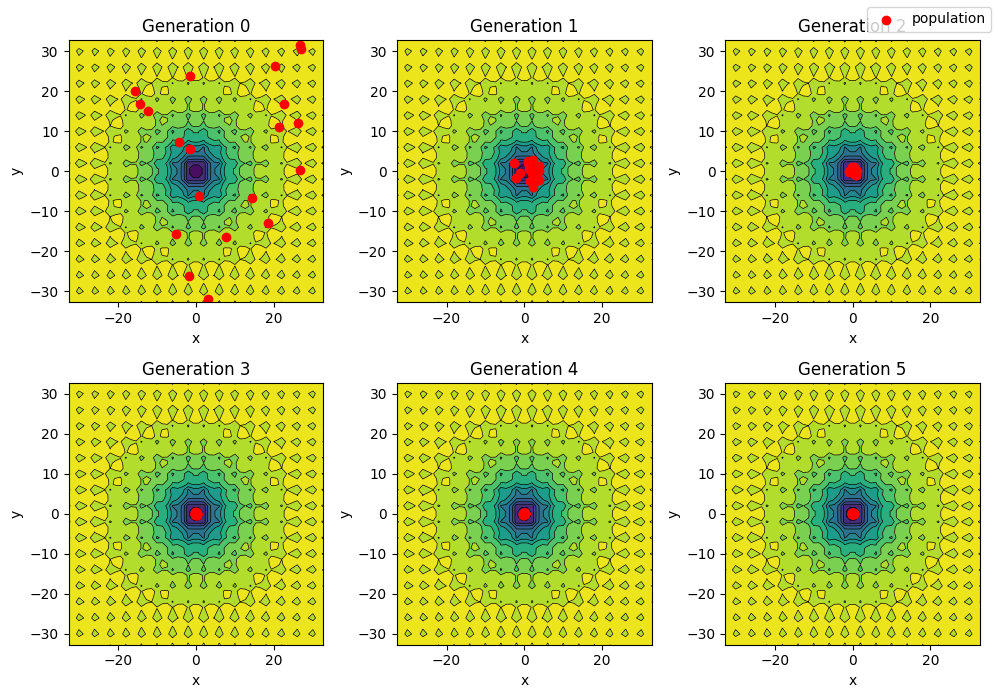

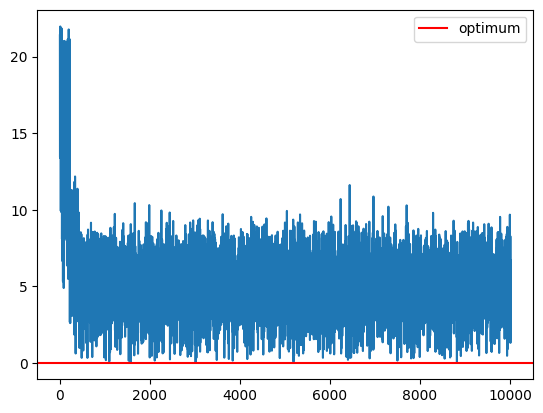

In [12]:
func = OptFun(bf.Ackley(2))

args = {}
args["num_vars"] = 2 # Number of dimensions of the search space
args["max_generations"] = 50
args["sigma"] = 1.0 # default standard deviation
args["pop_init_range"] = func.bounds()[0] # Range for the initial population
args["pop_size"] = 20 # mu
num_offspring = [20, 40, 100, 200] #lambda -> quanti figli genera ad ogni iterazione
args["mixing_number"] = 5 #rho
args["strategy_mode"] = None

for offspring in num_offspring:
    print(f'NUM OFFSPRING: {offspring}')
    func = OptFun(bf.Ackley(2))
    args["num_offspring"] = offspring
    best_guy, best_fitness, final_pop, all_populations = run_es(
        Random(0),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func)
    func.plot()

### rho

MIXING NUMBER: 2
BEST GUY: [-124.8556265   420.86682308], 	 BEST FITNESS: 296.10813900009896


<Figure size 640x480 with 0 Axes>

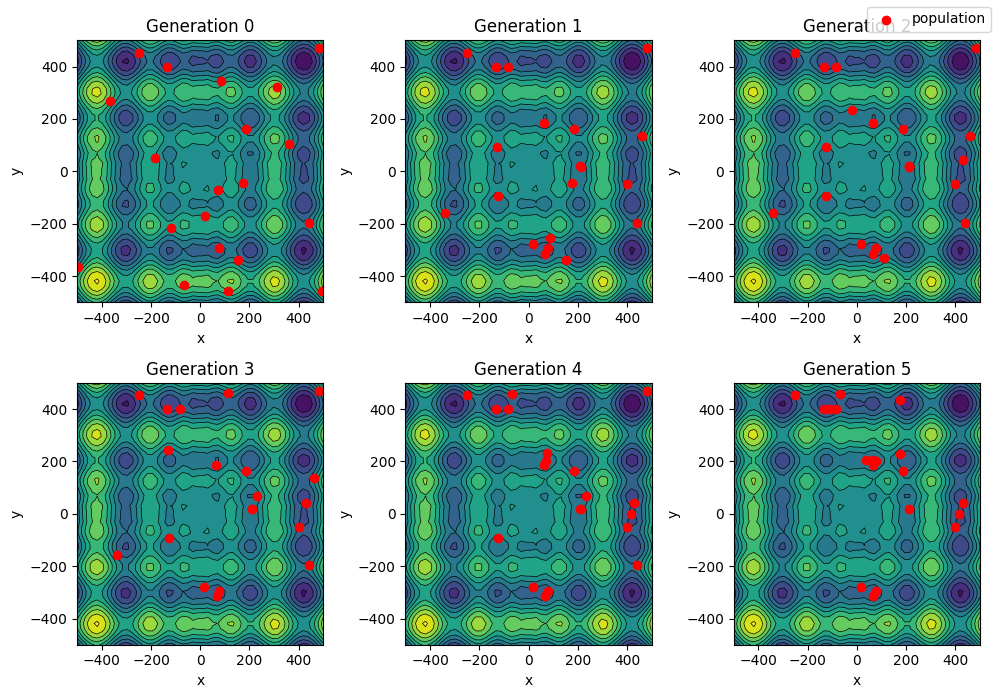

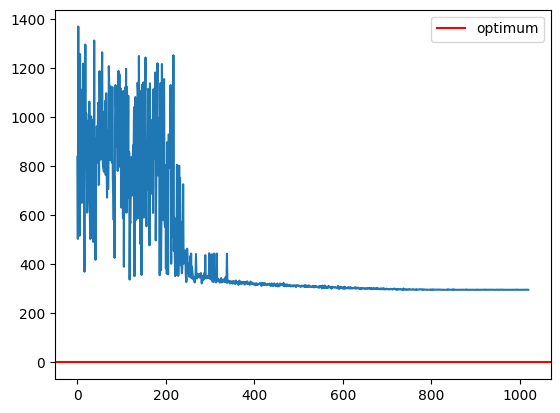

MIXING NUMBER: 3
BEST GUY: [-133.85439834  398.19624454], 	 BEST FITNESS: 369.733849523254


<Figure size 640x480 with 0 Axes>

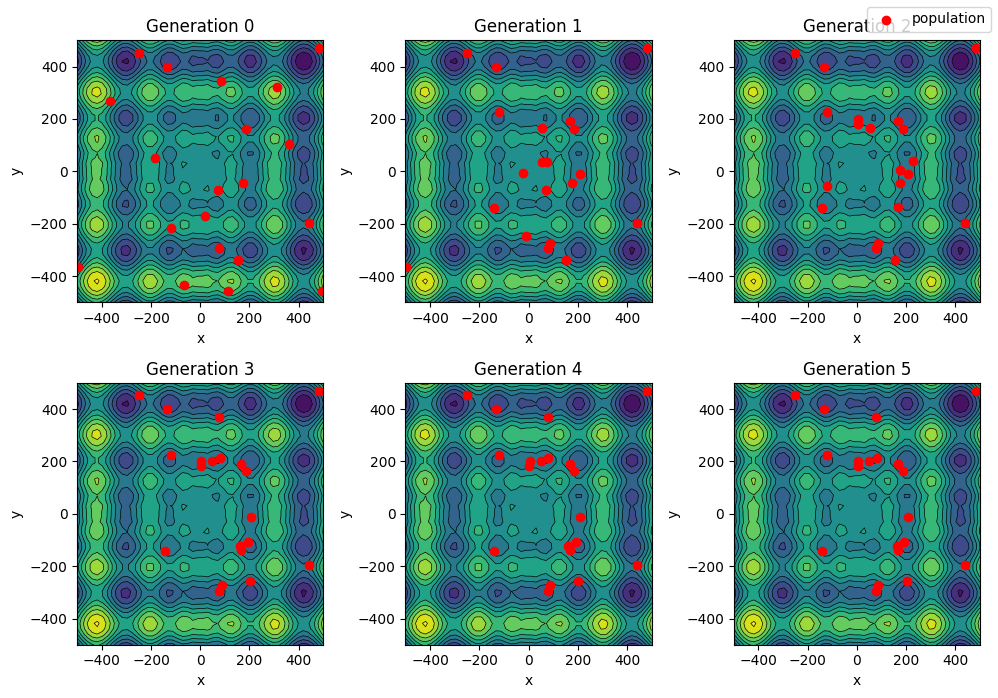

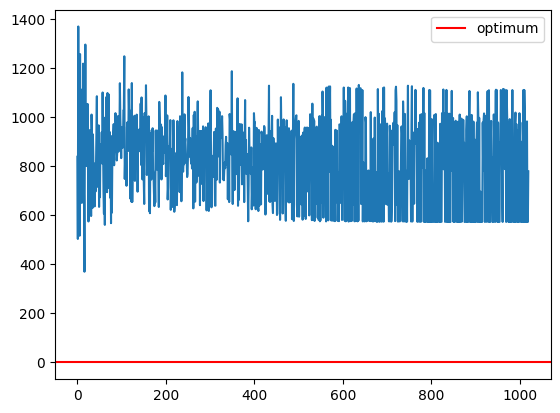

MIXING NUMBER: 4
BEST GUY: [-133.85439834  398.19624454], 	 BEST FITNESS: 369.733849523254


<Figure size 640x480 with 0 Axes>

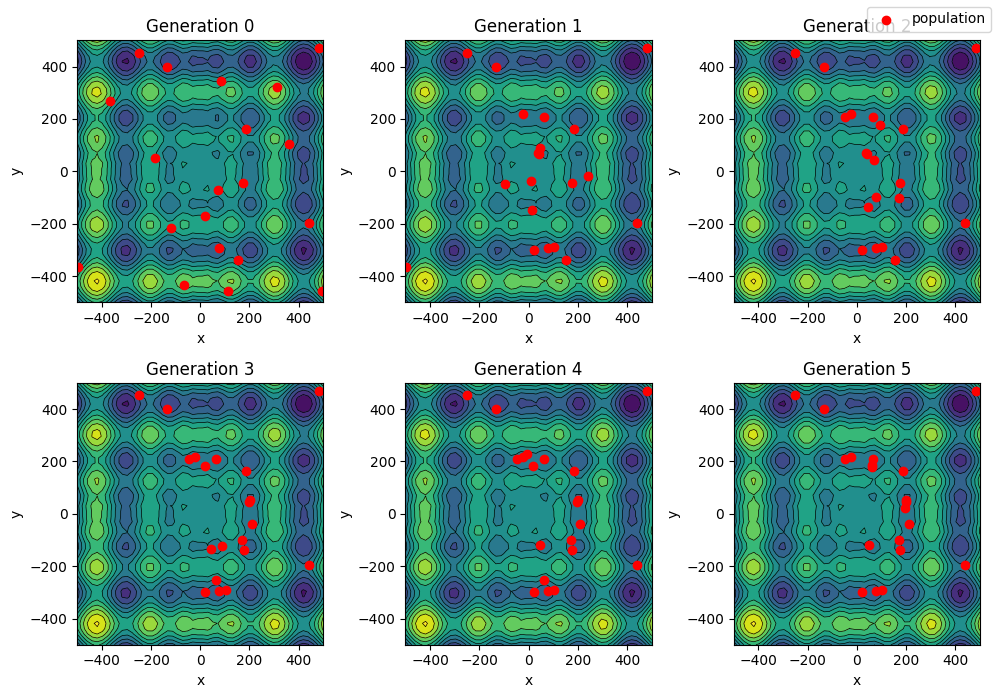

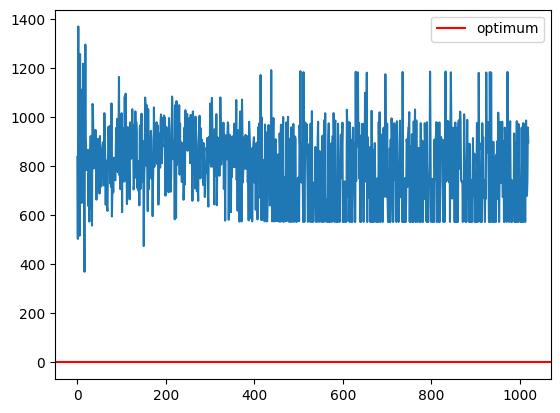

MIXING NUMBER: 5
BEST GUY: [-133.85439834  398.19624454], 	 BEST FITNESS: 369.733849523254


<Figure size 640x480 with 0 Axes>

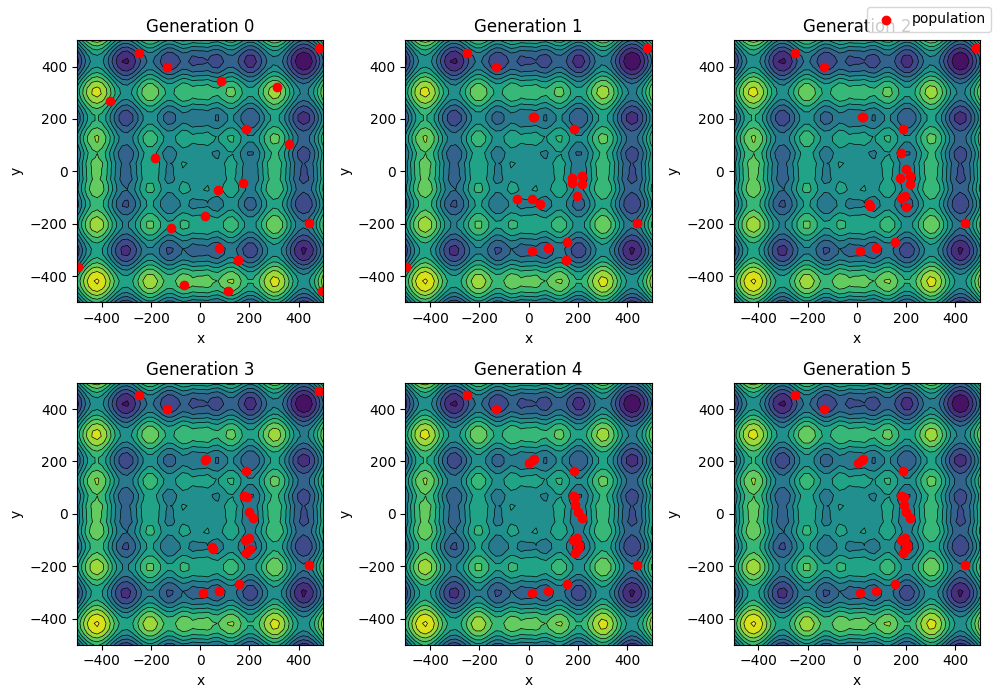

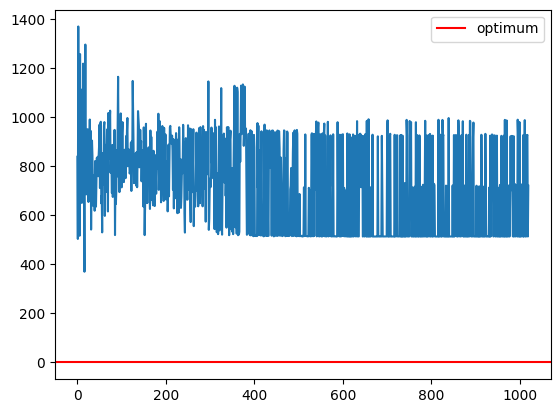

MIXING NUMBER: 6
BEST GUY: [-133.85439834  398.19624454], 	 BEST FITNESS: 369.733849523254


<Figure size 640x480 with 0 Axes>

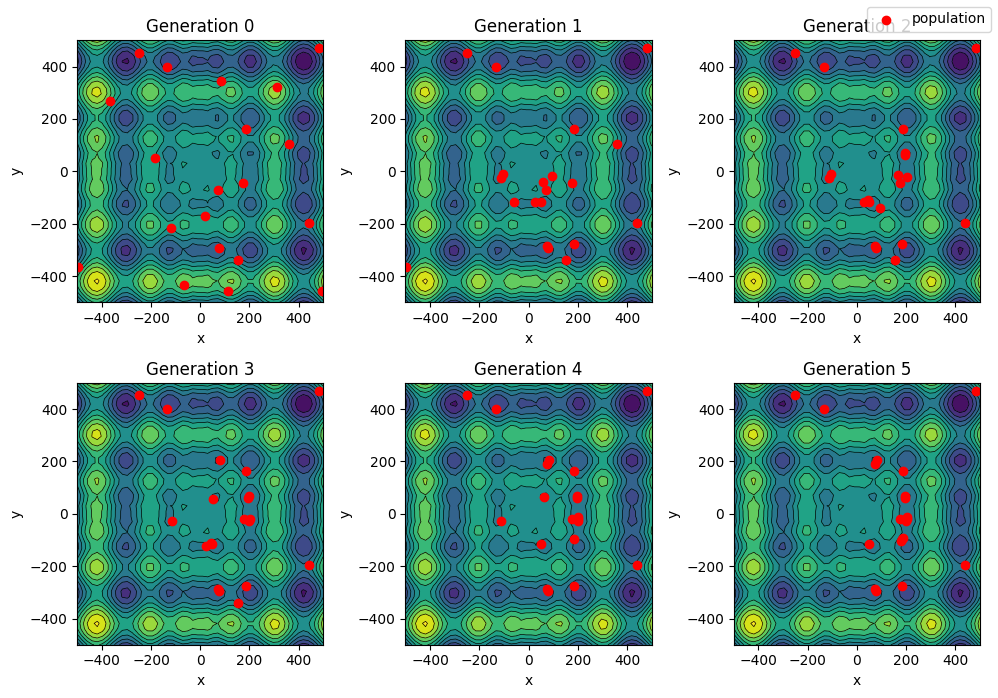

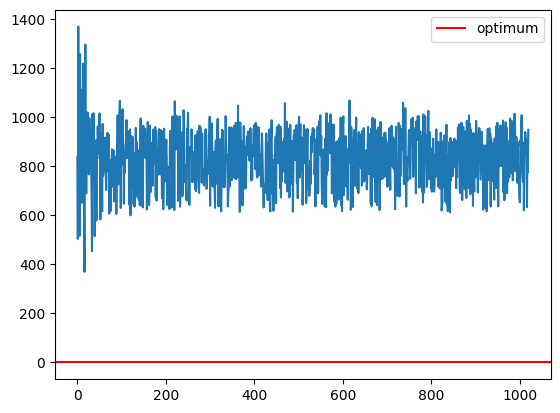

MIXING NUMBER: 10
BEST GUY: [-133.85439834  398.19624454], 	 BEST FITNESS: 369.733849523254


<Figure size 640x480 with 0 Axes>

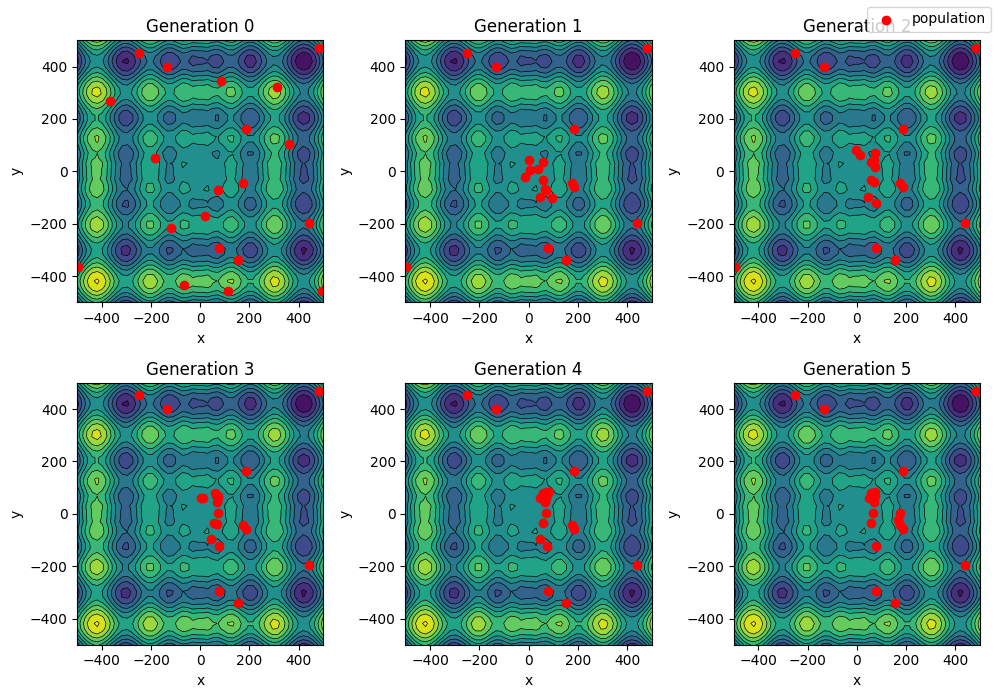

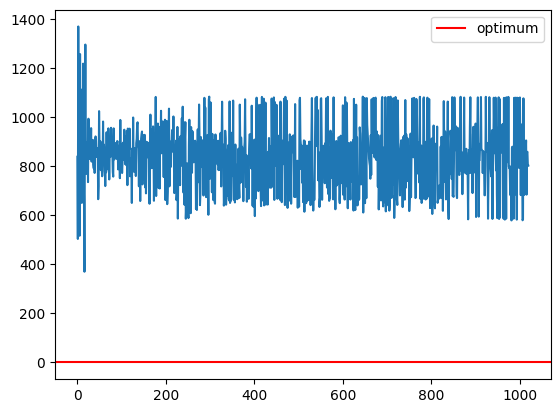

MIXING NUMBER: 20
BEST GUY: [-133.85439834  398.19624454], 	 BEST FITNESS: 369.733849523254


<Figure size 640x480 with 0 Axes>

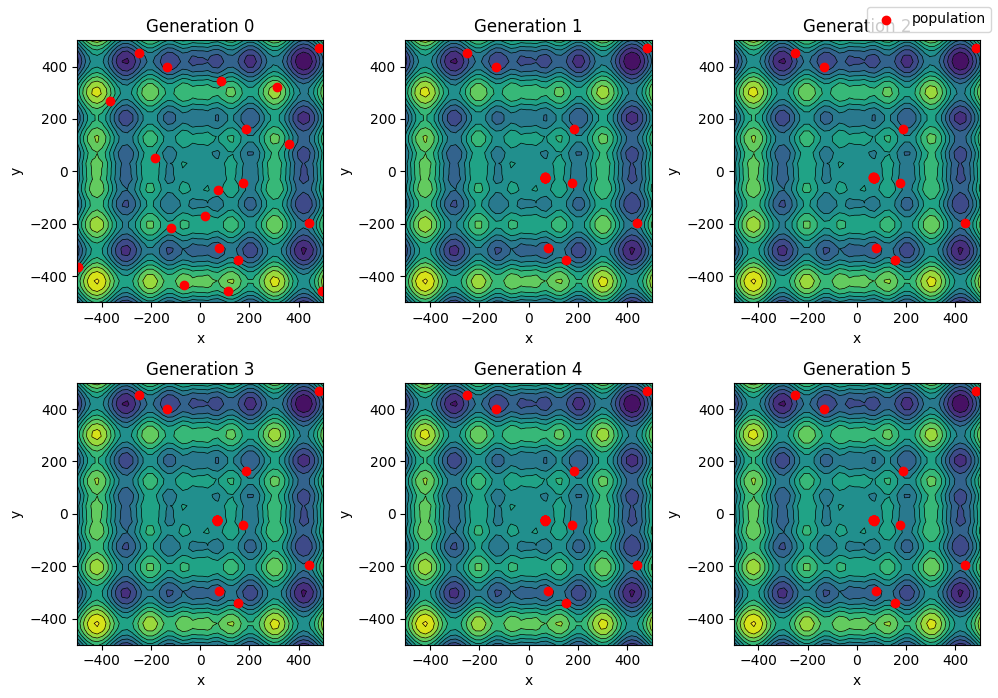

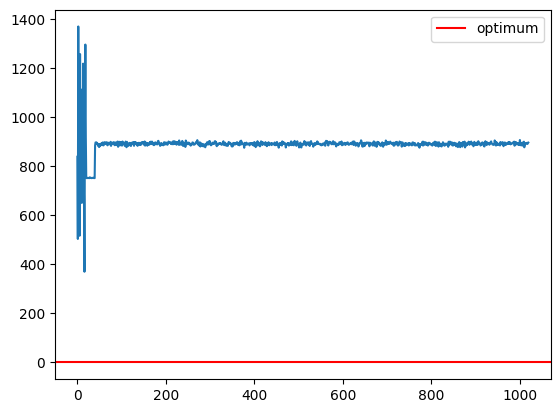

In [102]:
func = OptFun(bf.Schwefel(2))

args = {}
args["num_vars"] = 2 # Number of dimensions of the search space
args["max_generations"] = 50
args["sigma"] = 1.0 # default standard deviation
args["pop_init_range"] = func.bounds()[0] # Range for the initial population
args["pop_size"] = 20 # mu
args["num_offspring"] = 20 #lambda -> quanti figli genera ad ogni iterazione
mixing_number = [2, 3, 4, 5, 6, 10, 20] #rho
args["strategy_mode"] = None

for rho in mixing_number:
    print(f'MIXING NUMBER: {rho}')
    func = OptFun(bf.Schwefel(2))
    args["mixing_number"] = rho
    best_guy, best_fitness, final_pop, all_populations = run_es(
        Random(10),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func)
    func.plot()

### different strategies

STRATEGY: None
BEST GUY: [-0.06335176  0.02152266], 	 BEST FITNESS: 0.30446728423837444


<Figure size 640x480 with 0 Axes>

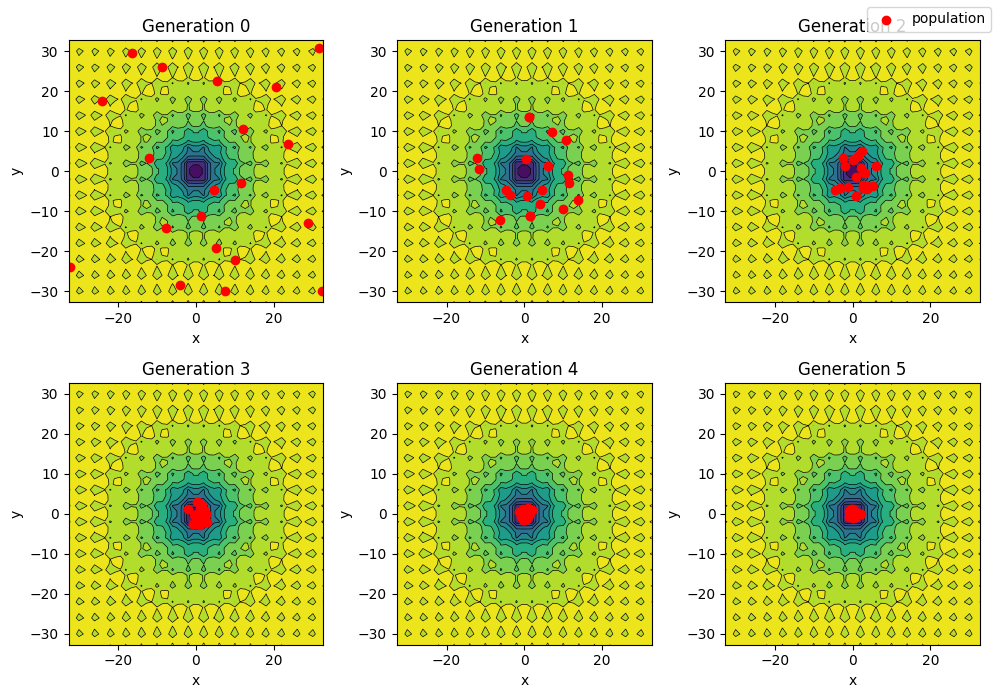

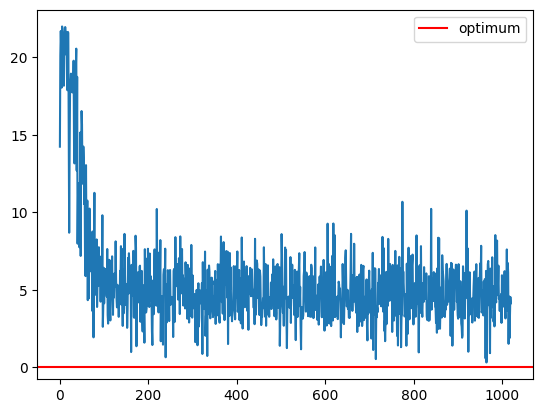

STRATEGY: Global
BEST GUY: [0.00061749 0.00028552], 	 BEST FITNESS: 0.0019365312712484872


<Figure size 640x480 with 0 Axes>

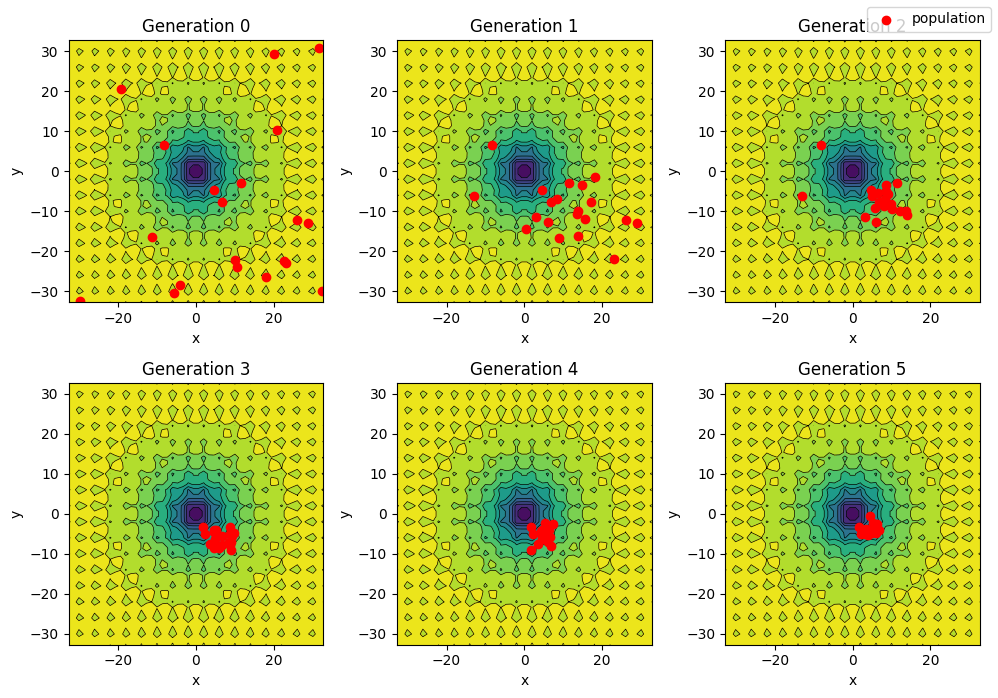

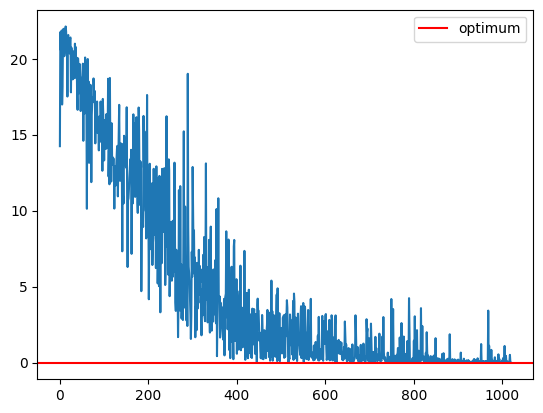

STRATEGY: Individual
BEST GUY: [ 0.00248052 -0.0035584 ], 	 BEST FITNESS: 0.012769672618273109


<Figure size 640x480 with 0 Axes>

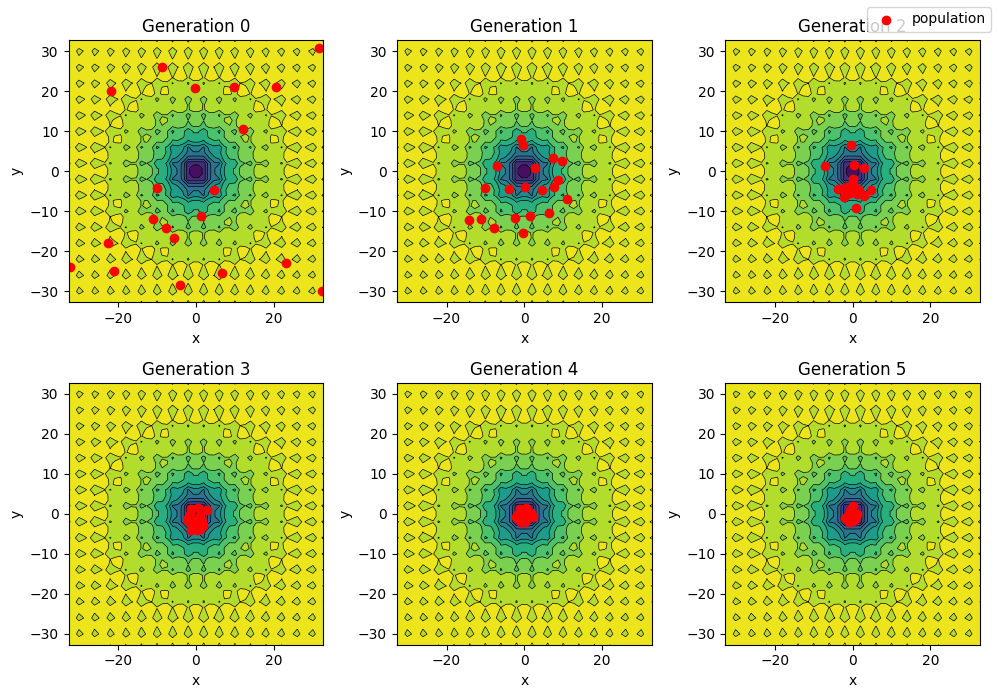

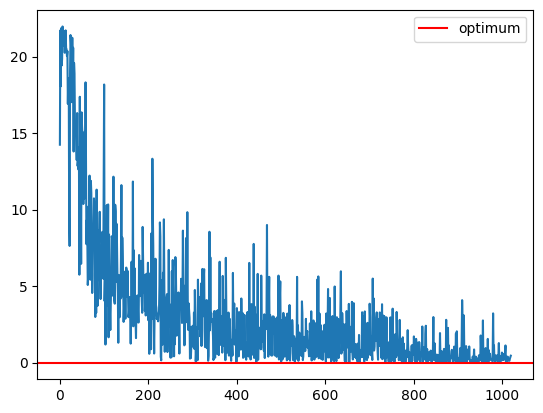

STRATEGY: Correlated


Exception: NumpyRandomWrapper required for correlated mutations

In [104]:
func = OptFun(bf.Ackley(2))

args = {}
args["num_vars"] = 2 # Number of dimensions of the search space
args["max_generations"] = 50
args["sigma"] = 1.0 # default standard deviation
args["pop_init_range"] = func.bounds()[0] # Range for the initial population
args["pop_size"] = 20 # mu
args["num_offspring"] = 20 #lambda -> quanti figli genera ad ogni iterazione
args["mixing_number"] = 5 #rho
strategy_mode =[ None, GLOBAL, INDIVIDUAL]

for strategy in strategy_mode:
    print(f'STRATEGY: {strategy}')
    func = OptFun(bf.Ackley(2))
    args["strategy_mode"] = strategy
    best_guy, best_fitness, final_pop, all_populations = run_es(
        Random(10),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func)
    func.plot()

#### Exercise 3/3: Particle Swarm Optimization

1. How does PSO compare to GA on different benchmark functions?

PSO tends to converge more rapidly compared to GA, especially in problems where the structure of the global optimum is evident, and the optimization landscape is relatively simple. However, PSO has a tendency to favor exploitation of known solutions, which can lead to premature convergence, particularly in the presence of multiple local minima or multimodal functions. In contrast, GAs are more robust to noise and can avoid local minima due to their population-based nature. Although they may require more time to achieve significant results, GAs are capable of more comprehensive exploration of the solution space and can achieve competitive performance, especially in complex environments or with multiple local optima.

2. How does PSO compare to ES on different benchmark functions?

ES typically offers a more robust exploration of the solution space due to its mutation-based search mechanism, which allows for greater diversity in the population. This characteristic enables ES to better avoid local minima and navigate complex optimization landscapes. While ES may require more iterations to converge compared to PSO, it can achieve competitive performance, especially in challenging optimization scenarios with rugged landscapes or multiple local optima.

3. Vary the pop_size and the n. of generations in such a way that their product is always constant, and compare the outcome of the search (over multiple runs). What is better? To have higher pop_size or higher number of generations?

<Figure size 640x480 with 0 Axes>

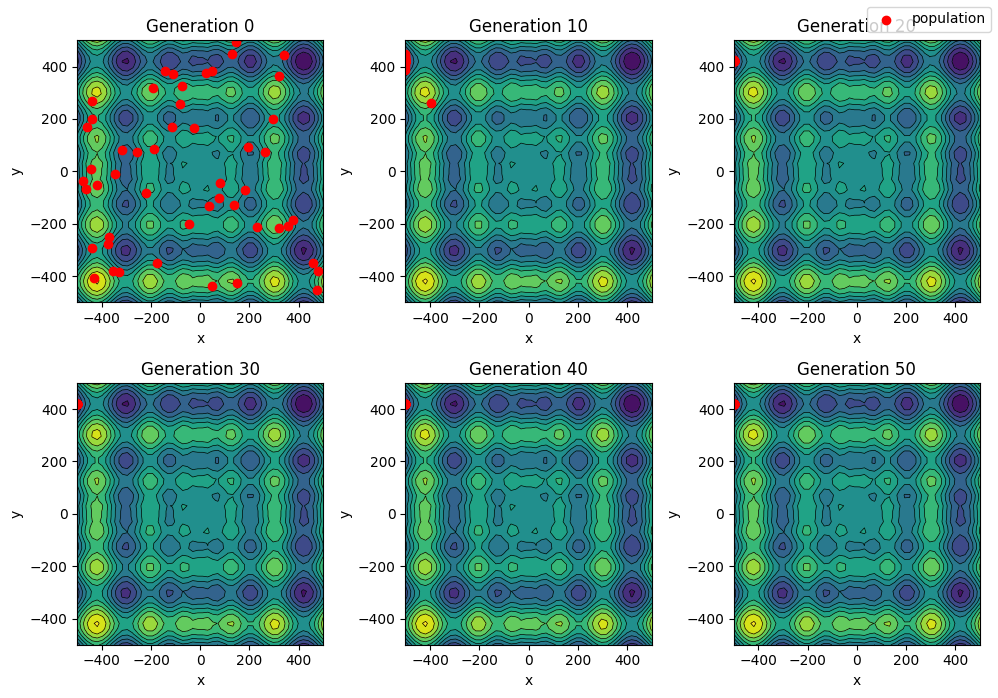

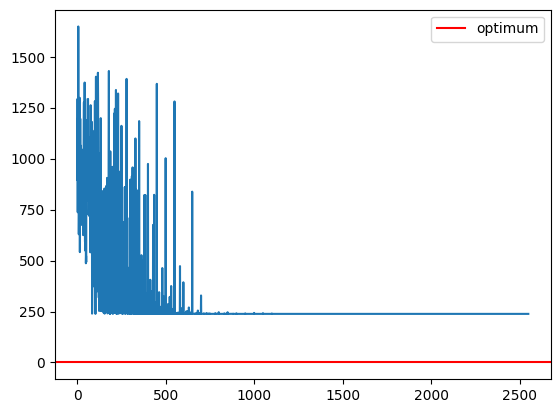

In [130]:
func = OptFun(bf.Schwefel(2))

args = {}
args["num_vars"] = 2 # Number of dimensions of the search space

args["pop_size"] = 50 #mu
args["topology"] = STAR #RING, STAR
args["neighborhood_size"] = 2   #used only for the ring topology
args["inertia"] = 0.3
args["cognitive_rate"] = 0.2
args["social_rate"] = 2.1
args["max_generations"] = 50

args["pop_init_range"] = func.bounds()[0] # Range for the initial population
best_guy, best_fitness, final_pop, all_populations = run_pso(
    Random(7),  # Seeded random number generator
    func,
    **args
)
plot_population_evolution(all_populations, func, generation_step=10)
func.plot()

<Figure size 640x480 with 0 Axes>

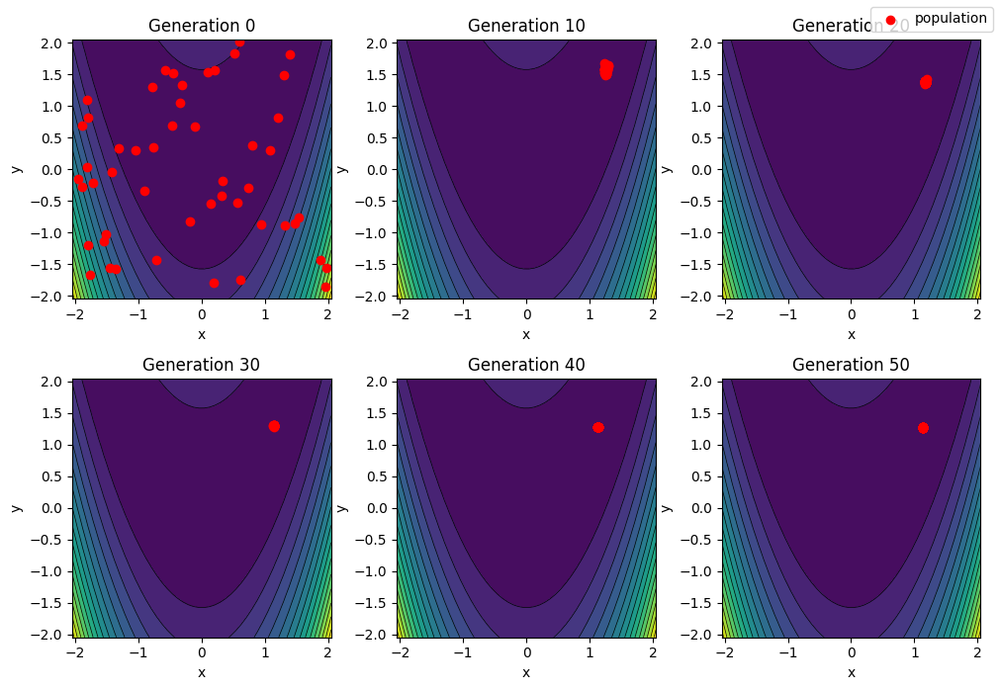

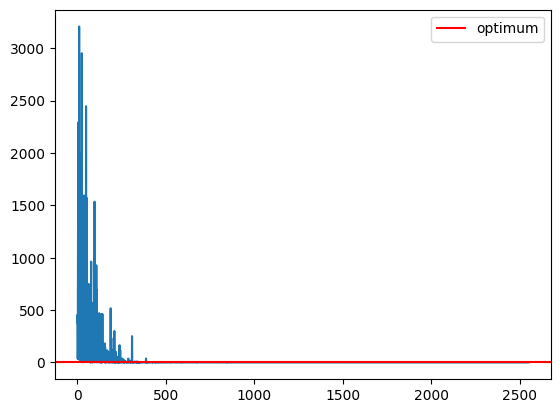

<Figure size 640x480 with 0 Axes>

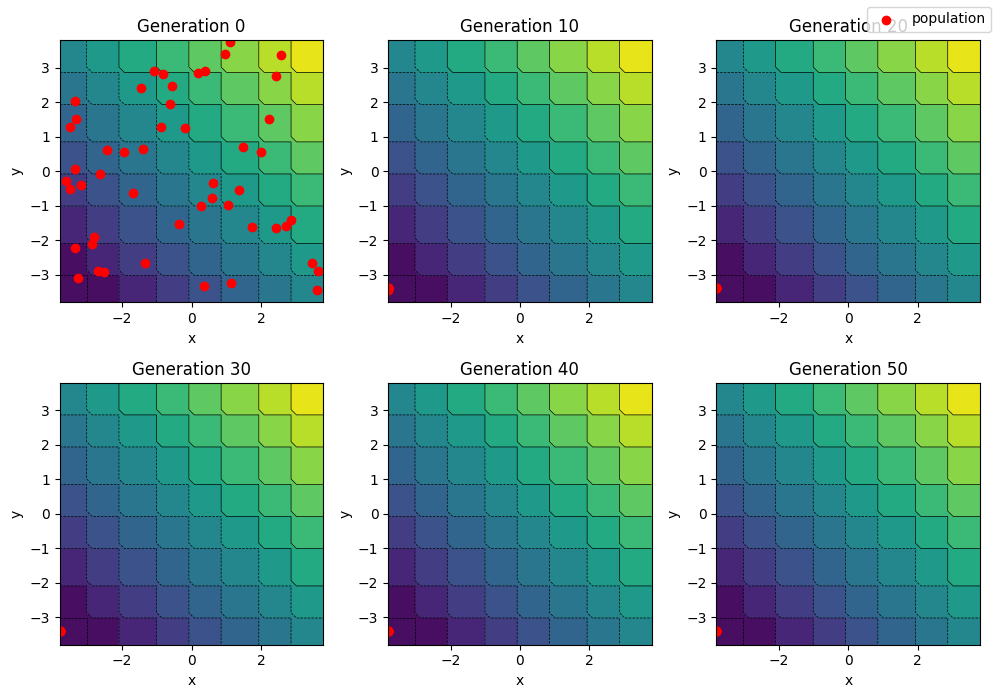

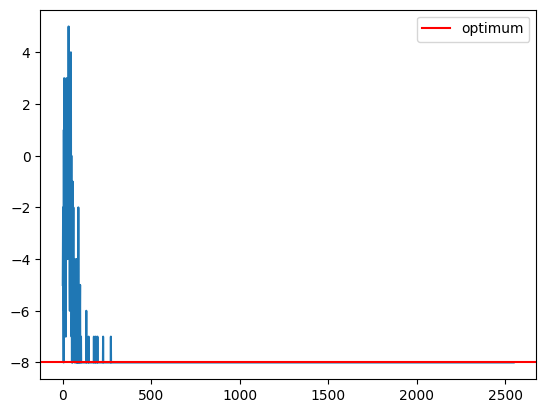

<Figure size 640x480 with 0 Axes>

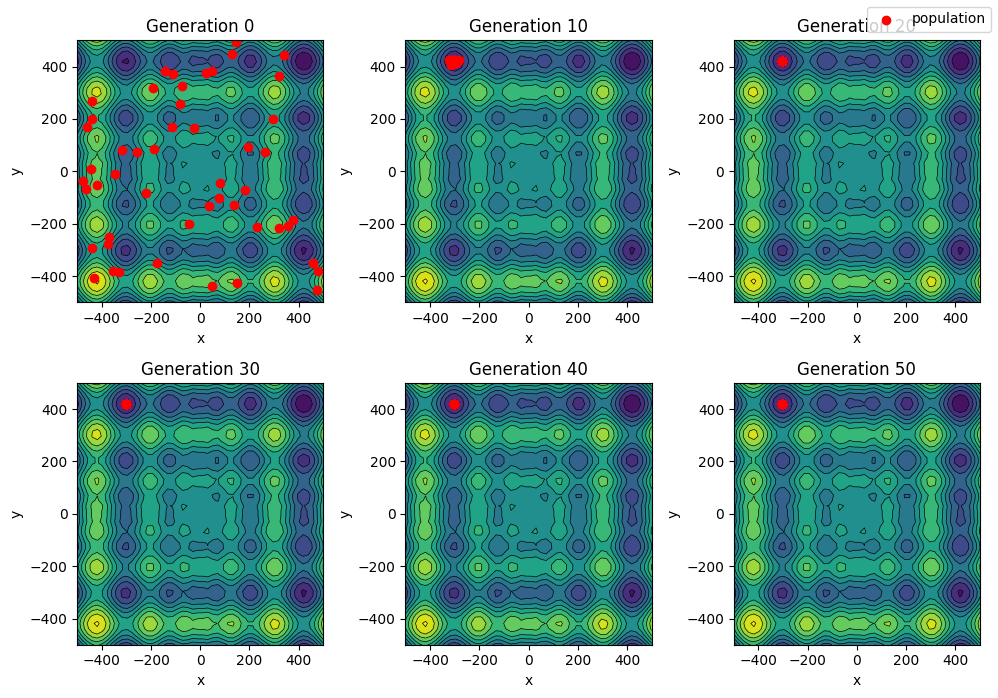

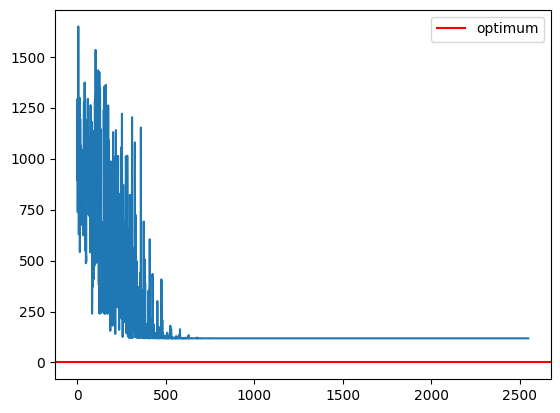

In [114]:
functions = [OptFun(bf.Rosenbrock(2)), OptFun(bf.DeJong3(2)), OptFun(bf.Schwefel(2))]

args = {}
args["num_vars"] = 2 # Number of dimensions of the search space

args["pop_size"] = 50 #mu
args["topology"] = STAR #RING, STAR
args["neighborhood_size"] = 2   #used only for the ring topology
args["inertia"] = 0.1
args["cognitive_rate"] = 0.2
args["social_rate"] = 2.1
args["max_generations"] = 50

for func in functions:
    args["pop_init_range"] = func.bounds()[0] # Range for the initial population
    best_guy, best_fitness, final_pop, all_populations = run_pso(
        Random(7),  # Seeded random number generator
        func,
        **args
    )

    plot_population_evolution(all_populations, func, generation_step=10)
    func.plot()



NUM OFFSPRING: 200
BEST GUY: [0.94887869 0.91479675], 	 BEST FITNESS: 0.02342426780562789


<Figure size 640x480 with 0 Axes>

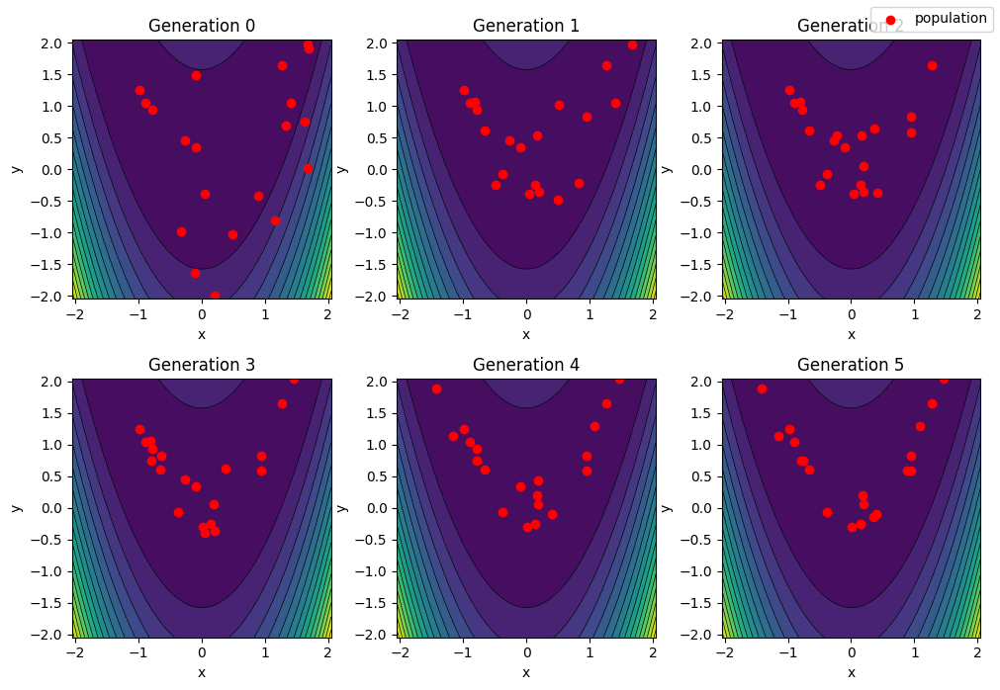

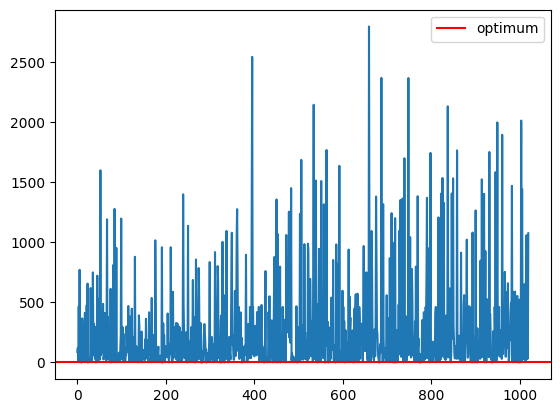

NUM OFFSPRING: 200
BEST GUY: [-3.75066747 -3.8       ], 	 BEST FITNESS: -8


<Figure size 640x480 with 0 Axes>

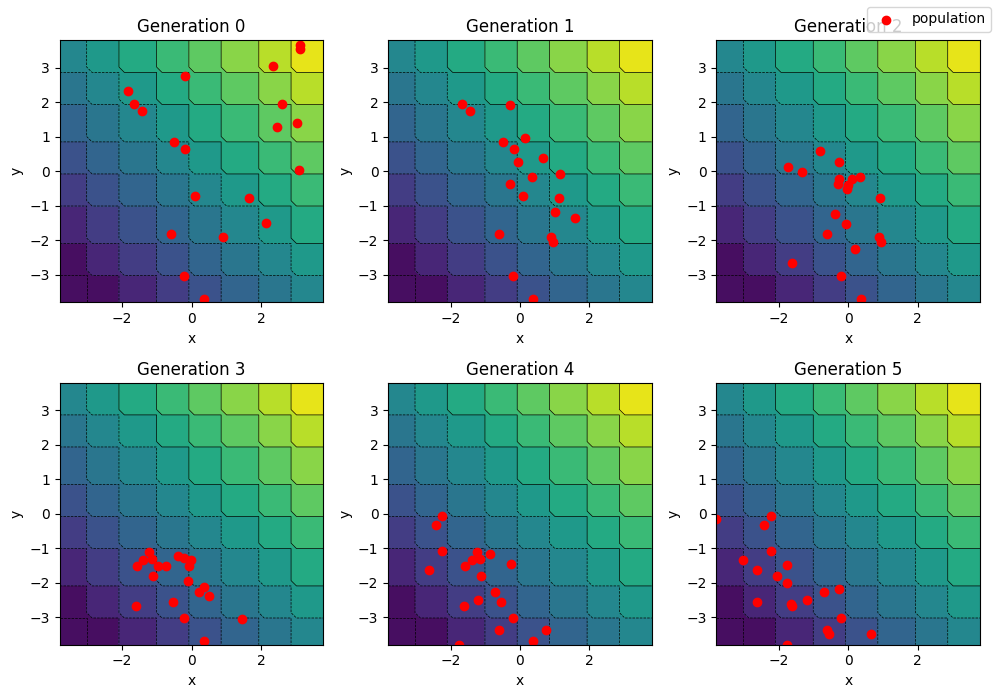

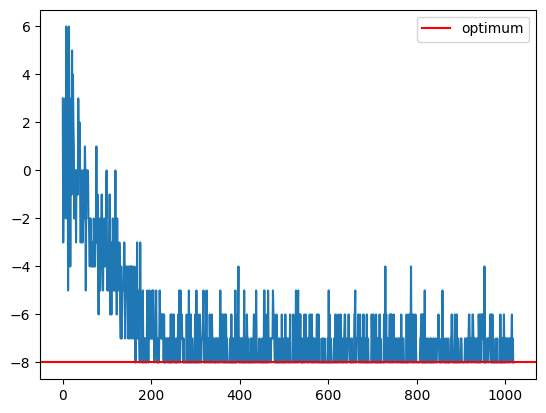

NUM OFFSPRING: 200
BEST GUY: [413.01105324 466.60636777], 	 BEST FITNESS: 249.49266256302462


<Figure size 640x480 with 0 Axes>

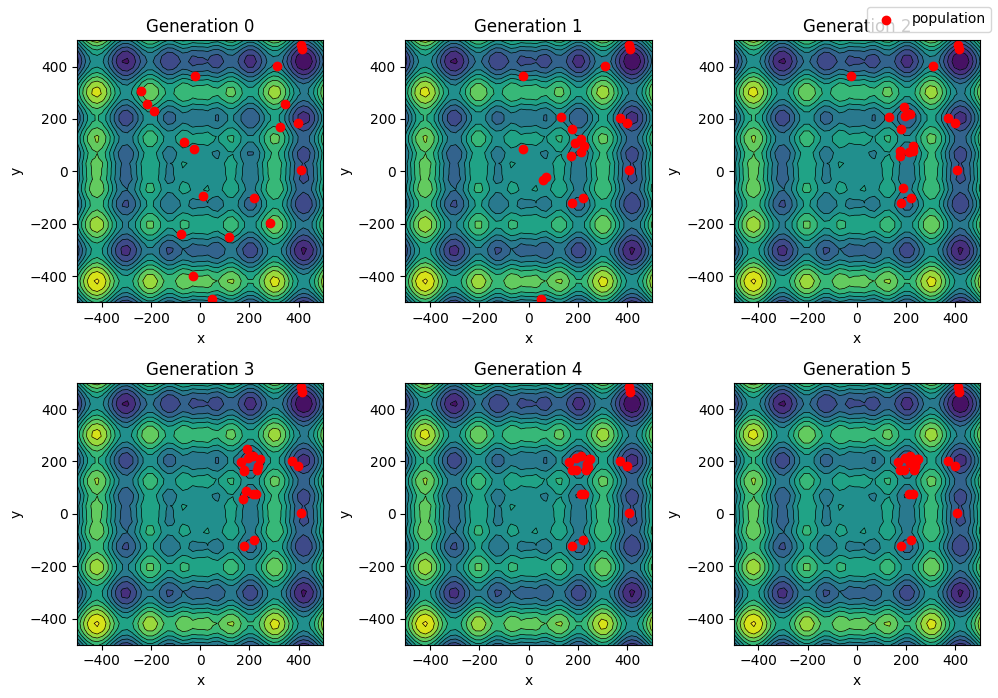

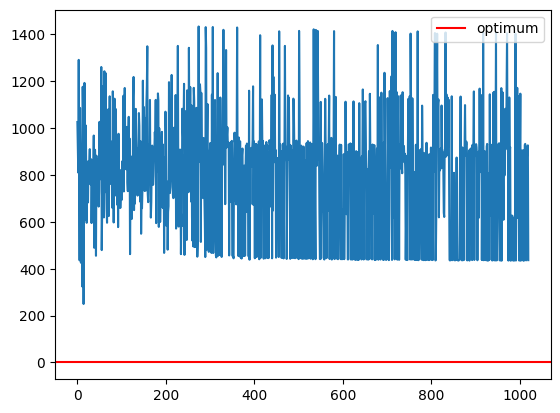

In [111]:
functions = [OptFun(bf.Rosenbrock(2)), OptFun(bf.DeJong3(2)), OptFun(bf.Schwefel(2))]

args = {}
args["num_vars"] = 2 # Number of dimensions of the search space
args["max_generations"] = 50
args["sigma"] = 1.0 # default standard deviation

args["pop_size"] = 20 # mu
args["num_offspring"] = 20#lambda -> quanti figli genera ad ogni iterazione
args["mixing_number"] = 5 #rho
args["strategy_mode"] = None

for func in functions:
    args["pop_init_range"] = func.bounds()[0] # Range for the initial population
    print(f'NUM OFFSPRING: {offspring}')
       
    best_guy, best_fitness, final_pop, all_populations = run_es(
        Random(0),  # Seeded random number generator
        func,
        **args
    )
    print(f'BEST GUY: {best_guy}, \t BEST FITNESS: {best_fitness}')
    plot_population_evolution(all_populations, func)
    func.plot()